In [304]:
__author__ = 'alfiya'
%matplotlib inline
import cv2
import numpy as np
from matplotlib import pyplot as plt
from scipy.spatial.distance import euclidean
import seaborn as sns
sns.set()

from helpers import noise_type, level_of_detail

def level_of_detail(edge_map, threshold=32, block_size=(8, 8)):
    if isinstance(edge_map, str):
        img = cv2.imread(edge_map, 0)
        edge_map = cv2.Laplacian(img, cv2.CV_64F)
    
    bitmap = edge_map > threshold
    delta = np.zeros(edge_map.shape)
    i_step = block_size[0]
    j_step = block_size[1]
    denom = float(block_size[0]) * block_size[1]
    for i in np.arange(0, edge_map.shape[0], i_step):
        for j in np.arange(0, edge_map.shape[1], j_step):
            delta[i:i + i_step, j:j + j_step] =\
                bitmap[i:i + i_step, j:j + j_step].sum() / denom

    return delta

def noise_type(img):
    if isinstance(img, str):
        img = cv2.imread(img, 0)

    noise = np.array([])
    img01 = np.roll(img, 1, axis=0)
    img0_1 = np.roll(img, -1, axis=0)
    img_10 = np.roll(img, -1, axis=1)
    img10 = np.roll(img, 1, axis=1)
    
    mask = (img != img01) & (img != img0_1) & (img != img_10) & (img != img10)
    noise = img[mask]
#     for i in np.arange(1, img.shape[0] - 1):
#         for j in np.arange(1, img.shape[1] - 1):            
#             if ((img[i, j] != img[i + 1, j]) and (img[i, j] != img[i - 1, j])
#                  and (img[i, j] != img[i, j + 1]) and (img[i, j] != img[i, j - 1])):
#                 noise = np.append(noise, img[i, j])

    nn = float(noise.size)
    n1 = (noise == 0).sum()
    n2 = (noise == 255).sum()
    n3 = ((noise > 0) & (noise < 255)).sum()
    if n3 / nn < 0.75:
        n_type = "salt and pepper"
    elif n1 / nn < 0.025 or n2 / nn < 0.025:
        n_type = "gaussian"
    else:
        n_type = "random"

    return n_type



def scale_0_n(X, scale=255):
    return (X - X.min()) * scale / (X.max() - X.min())

def magnitude(imgfile, verbose=False):
    if isinstance(imgfile, str):
        img = cv2.imread(imgfile, 0)
    else:
        img = imgfile
    dft = cv2.dft(np.float32(img), flags=cv2.DFT_COMPLEX_OUTPUT)
    dft_shift = np.fft.fftshift(dft)
    
    actual_magnitude = cv2.magnitude(dft_shift[:, :, 0], dft_shift[:, :, 1])
    
    if verbose:
        log_magnitude = np.log(actual_magnitude)
        # scale between 0 and 255
        magnitude_spectrum = scale_0_n(log_magnitude)

#         print "Image file", imgfile
        print "Image shape", img.shape, "Fourier shape", dft.shape
        plt.subplot(121), plt.imshow(img, cmap='Greys')
        plt.title('Input Image'), plt.xticks([]), plt.yticks([])
        plt.subplot(122), plt.imshow(magnitude_spectrum, cmap='Greys')
        plt.title('Magnitude Spectrum'), plt.xticks([]), plt.yticks([])
        plt.tight_layout()
        plt.show()
    return actual_magnitude


def circle_mask(X):
    m, n = X.shape
    a, b = int(m / 2), int(n / 2)
    y, x = np.ogrid[-a: m - a, -b: n - b]

    for r in np.arange(min(a,b) + 1, 0, -1):  # min(a, b) + 1
        if a == b:
            c_x = c_y = float(r)
        elif a < b:
            c_x = float(r) * b / a
            c_y = float(r)
        else:
            c_x = float(r)
            c_y = float(r) * a / b
        mask = ( x*x / (c_x**2) + y*y / (c_y**2) ) <= 1.

        yield mask


def magnitude_stats(actual_magnitude, verbose=False):
    total_energy = actual_magnitude.sum()
    energy = np.array([])
    n = 0
    for mask in circle_mask(actual_magnitude):
        circle_energy = actual_magnitude[mask].sum()
        if n == 0:
            total_energy = circle_energy
        energy = np.append(energy, circle_energy / total_energy)
        n += 1

    ideal_energy = (1 - (np.arange(n) / float(n))**(1.05))**(1/1.05)
    if verbose:
        plt.scatter(np.arange(1, energy.size + 1), energy)
        plt.plot(ideal_energy)
        plt.show()

    return energy, ideal_energy


def noise_score(img, edge_map, actual, ideal, delta_mean, E_t=0.035):
    pos = actual < ideal
    E_pos = (ideal[pos] - actual[pos]).sum() / ideal.sum() if pos.any() else 0
    if E_pos > E_t:
        eta = edge_map.mean() / edge_map.max()
        n_type = noise_type(img)
        if n_type != "gaussian":
            d_iqm = 1 - eta ** (0.0625 + delta_mean * (0.5 - 0.0625))
        else:
            d_iqm = 1 - eta ** (0.5 + delta_mean * (0.75 - 0.5))
    else:
        eta = 0
        d_iqm = 1.
        n_type = ""
    
        
    return E_pos, eta, d_iqm, n_type


def blur_score(img, edge_map, sharpened_edge_map, delta, actual, ideal, delta_mean, E_t=0.4): 
    neg = actual > ideal
    E_neg = (actual[neg] - ideal[neg]).sum() / ideal.sum() if neg.any() else 0
    if E_neg > E_t:
        beta = edge_map.mean() / edge_map.max()
        d_iqm = 1 - beta**(24 * (0.75 + (1 - delta_mean) * (1 - 0.75)))
    else:
        beta = 0
        d_iqm = 1.
       
    
    return E_neg, beta, d_iqm


def sharpen(img, edge_map):
    sharpened_img = img - edge_map
    sharpened_img = scale_0_n(sharpened_img)
    return sharpened_img

def blur_type(sharpened_edge_map, delta):
    threshold = 128 * (1 - delta)
    bitmap = sharpened_edge_map > delta
    

def self_correlation():
    pass

def fft_based_quality(imgfile, verbose=False):
    img = cv2.imread(imgfile, 0)
    
    magnitude_spectrum = magnitude(img, verbose)
    
    edge_map = cv2.Laplacian(img, cv2.CV_64F) 
    sharpened_img = sharpen(img, edge_map)
    sharpened_edge_map = scale_0_n(cv2.Laplacian(sharpened_img, cv2.CV_64F))
    edge_map = scale_0_n(edge_map)
    
    delta = level_of_detail(edge_map)
    delta_mean = delta.mean()
       
    ratio, ideal_ratio = magnitude_stats(magnitude_spectrum, verbose)
    
    mean, mx = edge_map.mean(), edge_map.max()
    E_pos, eta, d_iqm_noise, n_type = noise_score(img, edge_map, ratio, ideal_ratio, delta_mean)
    E_neg, beta, d_iqm_blur = blur_score(img, edge_map, sharpened_edge_map, delta, ratio, ideal_ratio, delta_mean)
    
    d_iqm = min(d_iqm_noise, d_iqm_blur)
    if verbose:
        print "positive energy", E_pos,"negative energy", E_neg, "delta_mean", delta_mean, "iqm", d_iqm, "eta", eta, "beta", beta, "type", n_type, "\n"
    return d_iqm

In [305]:
from load_tid import load_data
import json
import os
import pandas as pd
def load_data(filepath, folderpath, distortions_mapping_path):
    def get_distortion_type(x, mapping):
        t = x.split("_")[1]
        l = int(x.split("_")[-1].split(".")[0])
        return pd.Series({"type": t, "type_name": mapping.get(t), "level": l})

    mapping = json.load(open(distortions_mapping_path))
    df = pd.read_table(filepath, sep=" ", header=None,
                       names=["mos", "path"],
                       dtype=dict(mos=float, path=str))

    if pd.isnull(df).sum().sum() > 0:
        raise ValueError("NULL values in a dataset :(")
    X = df["path"].apply(lambda x: os.path.join(folderpath, x)).values
    y = df["mos"].values
    distortions = df["path"].apply(get_distortion_type, mapping=mapping)
    return X, y, distortions
X, y, distortions = load_data(
    "/Users/alfiya/Documents/work/Image Quality/tid2013/mos_with_names.txt",
    "/Users/alfiya/Documents/work/Image Quality/tid2013/distorted_images/",
    "/Users/alfiya/Documents/work/Image Quality/tid2013/distortions_mapping")

Image shape (384, 512) Fourier shape (384, 512, 2)


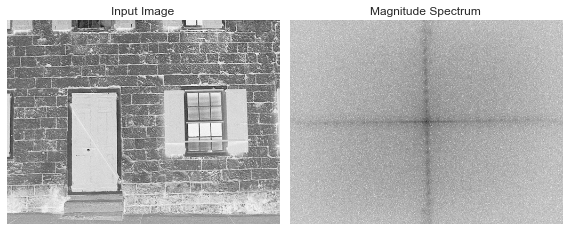

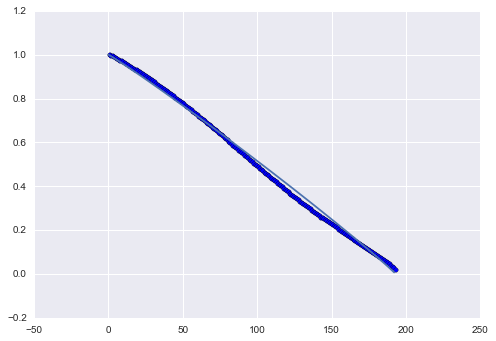

positive energy 0.0273687326941 negative energy 0.00455107979067 delta_mean 0.999989827474 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


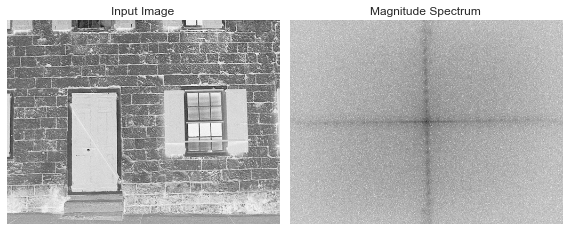

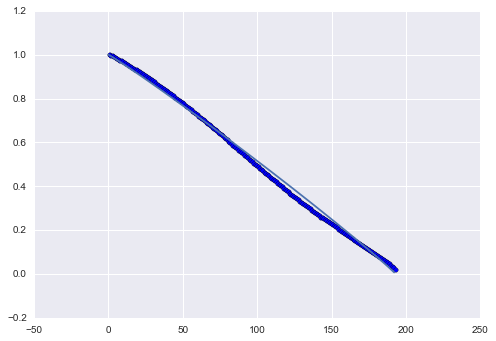

positive energy 0.0273687326941 negative energy 0.00455107979067 delta_mean 0.999989827474 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


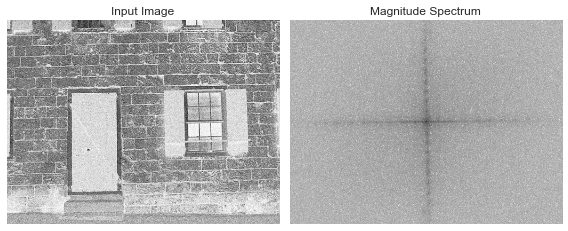

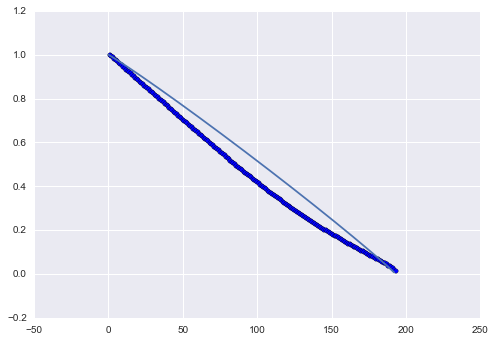

positive energy 0.122799870694 negative energy 0.000257262233426 delta_mean 0.999857584635 iqm 0.381278310308 eta 0.527206297893 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


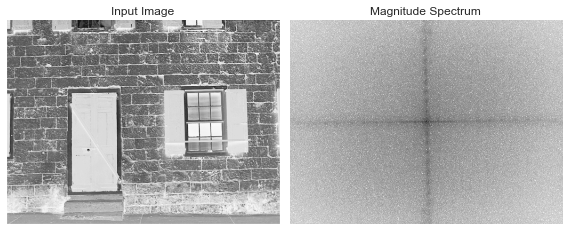

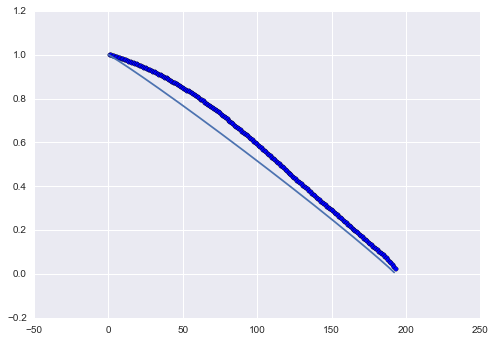

positive energy 0 negative energy 0.0972843811596 delta_mean 0.999989827474 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


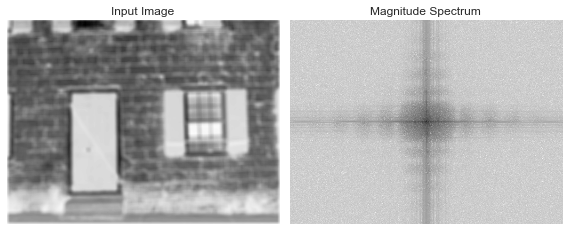

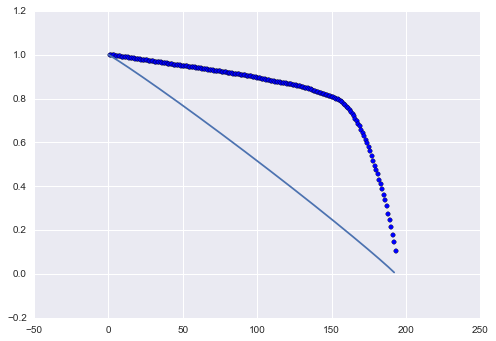

positive energy 0 negative energy 0.595252092477 delta_mean 0.996470133464 iqm 0.999999999984 eta 0 beta 0.25189420912 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


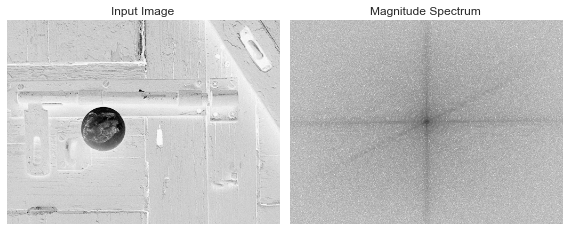

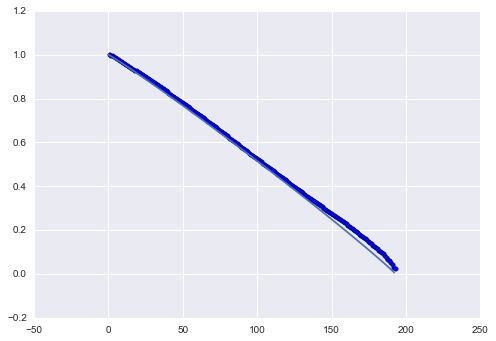

positive energy 3.57647508718e-06 negative energy 0.0203378731339 delta_mean 0.999928792318 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


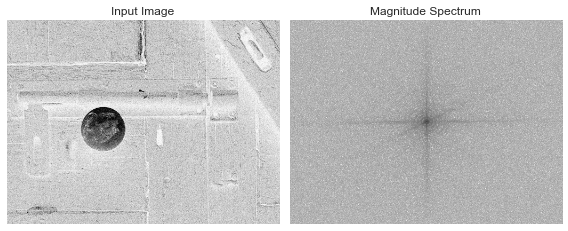

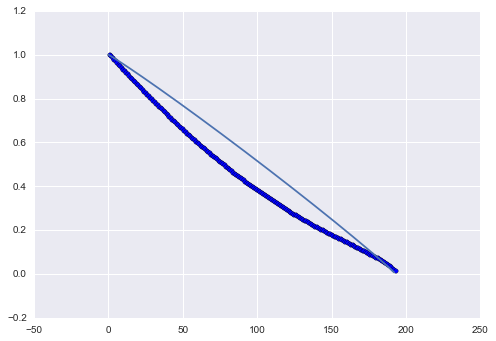

positive energy 0.16713352171 negative energy 0.000327590378049 delta_mean 0.999938964844 iqm 0.384180180354 eta 0.523921038232 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


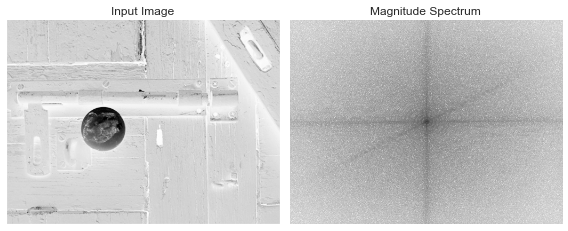

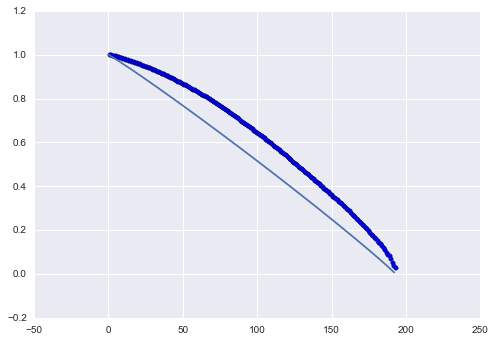

positive energy 0 negative energy 0.172483941887 delta_mean 0.999984741211 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


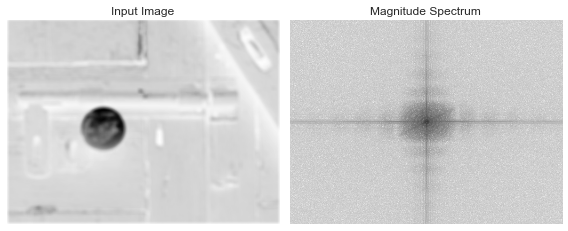

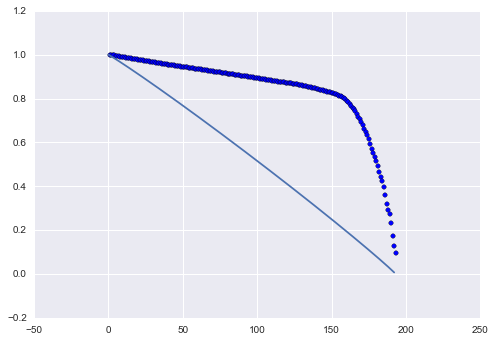

positive energy 0 negative energy 0.606296465564 delta_mean 0.999750773112 iqm 0.999999998758 eta 0 beta 0.32009194114 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


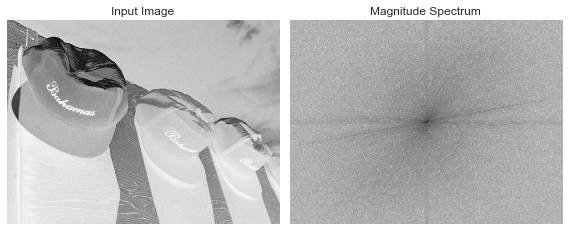

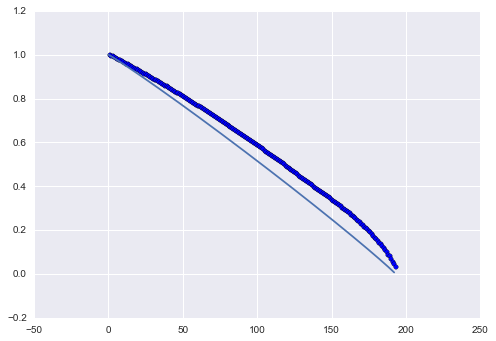

positive energy 0 negative energy 0.103591371362 delta_mean 0.999852498372 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


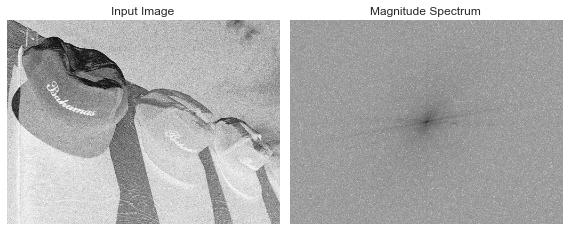

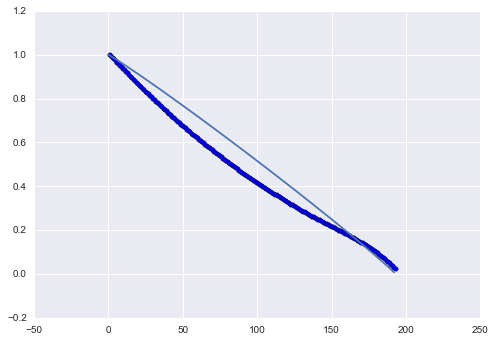

positive energy 0.12310918021 negative energy 0.00275852130848 delta_mean 0.999837239583 iqm 0.406002245219 eta 0.49930207748 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


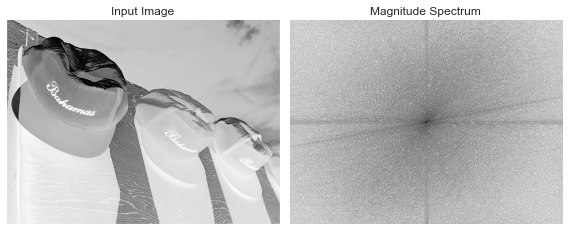

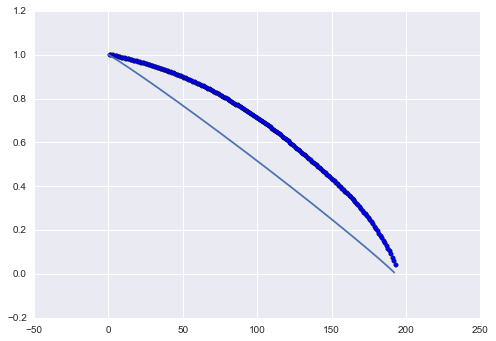

positive energy 0 negative energy 0.263724000745 delta_mean 0.999567667643 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


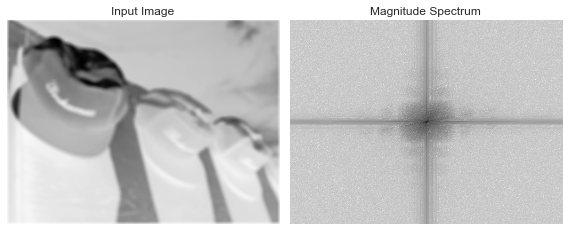

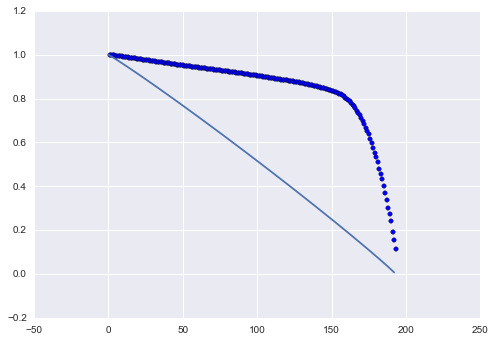

positive energy 0 negative energy 0.623996945848 delta_mean 0.999888102214 iqm 0.999999999213 eta 0 beta 0.312053899655 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


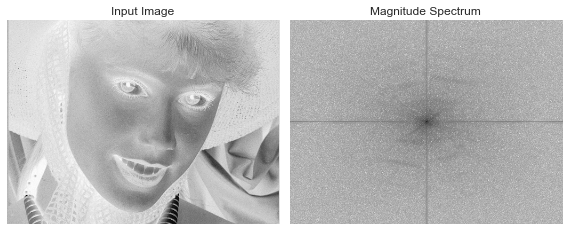

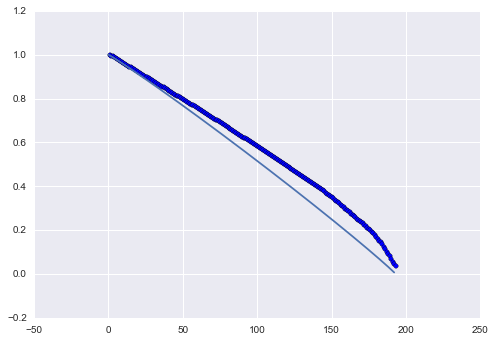

positive energy 1.27581664808e-06 negative energy 0.0999094904979 delta_mean 0.999974568685 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


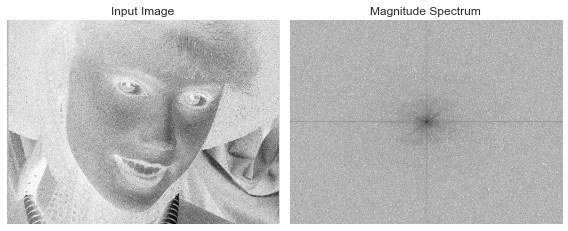

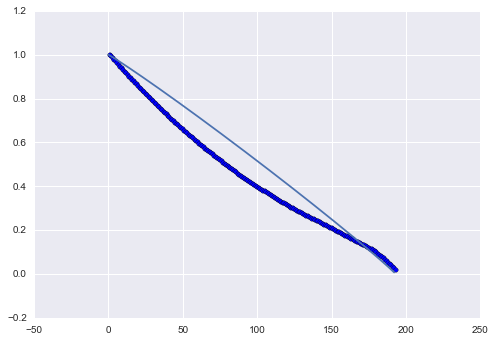

positive energy 0.144386469504 negative energy 0.00235421744124 delta_mean 0.999969482422 iqm 0.370731954413 eta 0.539235128334 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


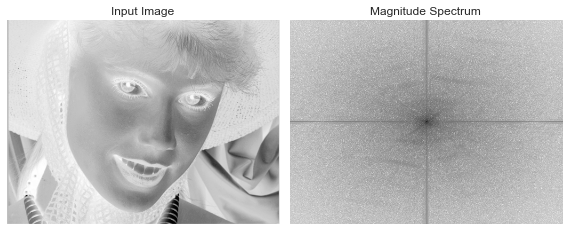

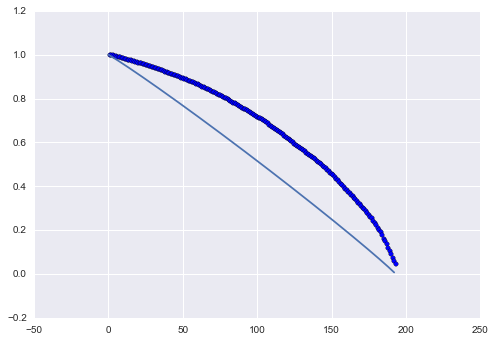

positive energy 0 negative energy 0.273862703008 delta_mean 0.999984741211 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


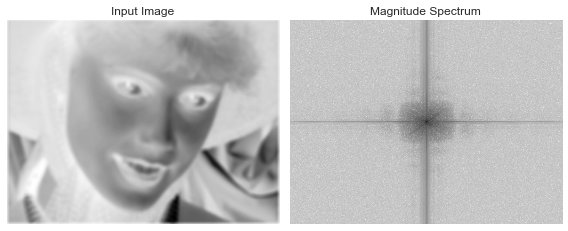

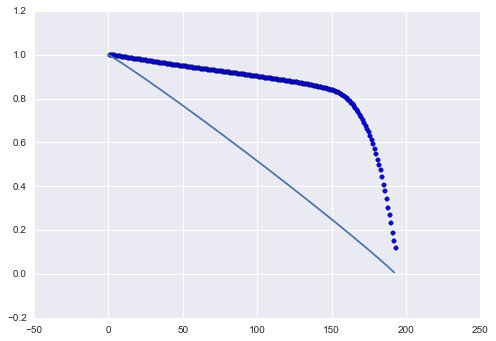

positive energy 0 negative energy 0.622999151477 delta_mean 0.995488484701 iqm 0.999999999999 eta 0 beta 0.209606100012 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


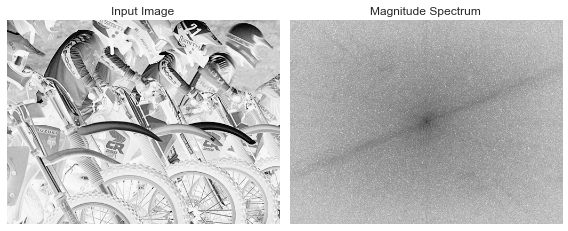

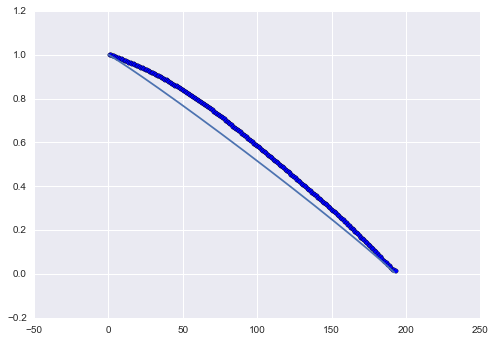

positive energy 0 negative energy 0.0860901548217 delta_mean 0.99994913737 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


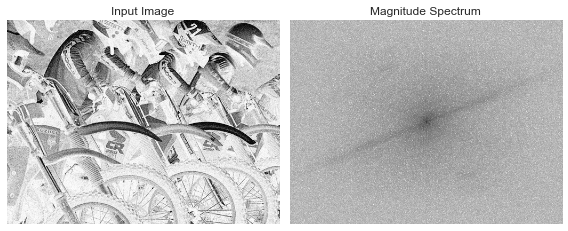

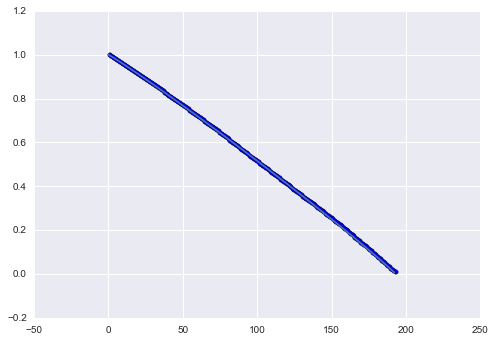

positive energy 0.0063739274866 negative energy 0.000116612273139 delta_mean 0.999883015951 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


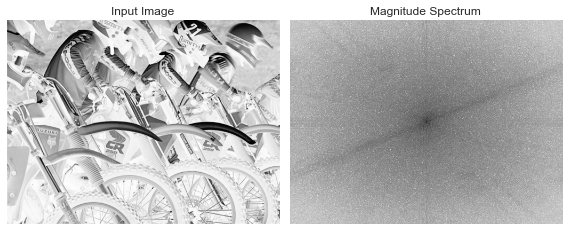

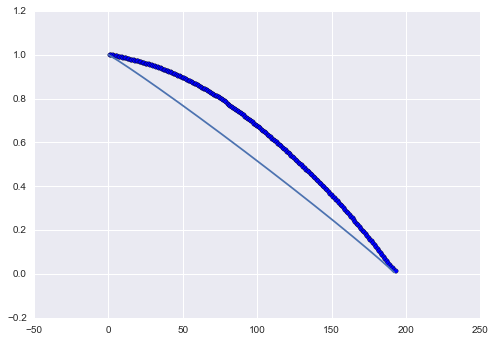

positive energy 0 negative energy 0.194395898151 delta_mean 0.999969482422 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


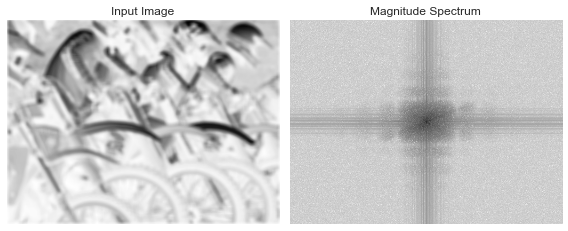

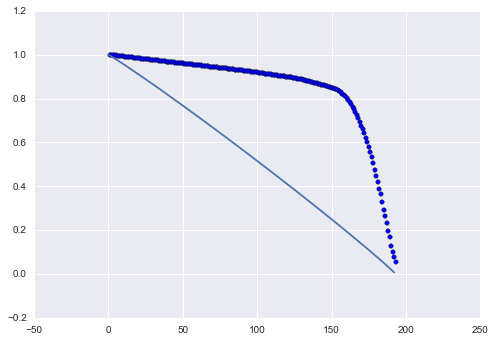

positive energy 0 negative energy 0.620960290972 delta_mean 0.996724446615 iqm 0.999999999996 eta 0 beta 0.231831020779 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


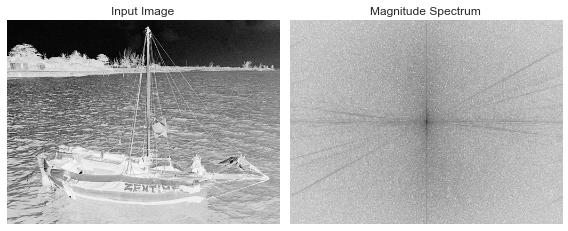

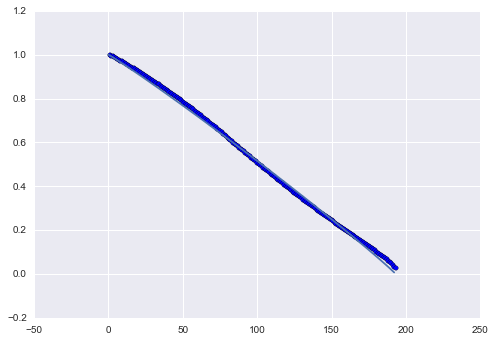

positive energy 0.0102720585951 negative energy 0.0110129499357 delta_mean 0.999628702799 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


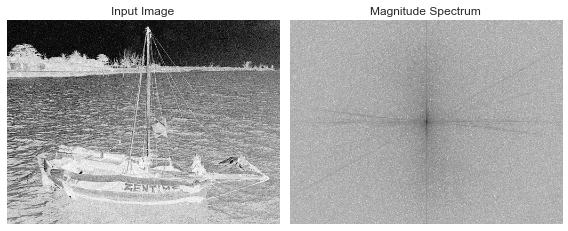

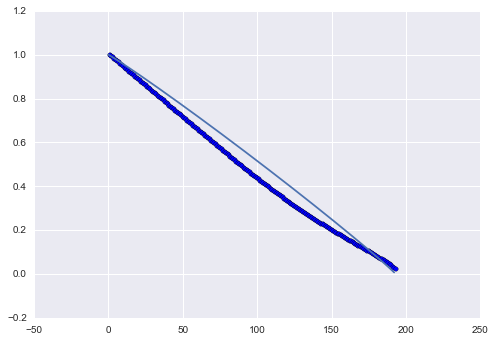

positive energy 0.0971549041338 negative energy 0.0010474193724 delta_mean 0.999827067057 iqm 0.488972400754 eta 0.408542019303 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


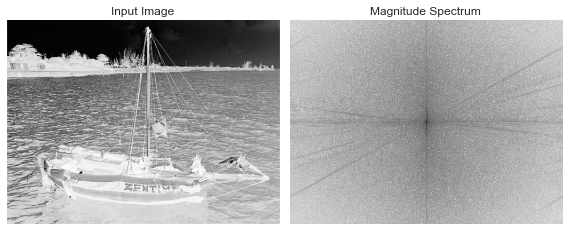

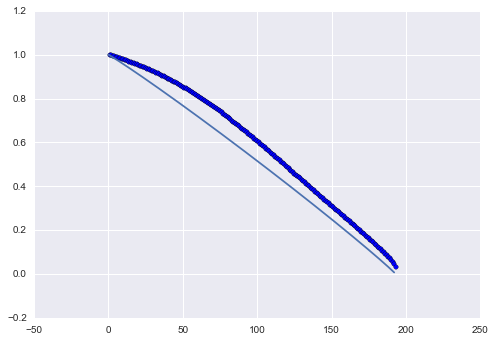

positive energy 0 negative energy 0.120230555866 delta_mean 0.999811808268 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


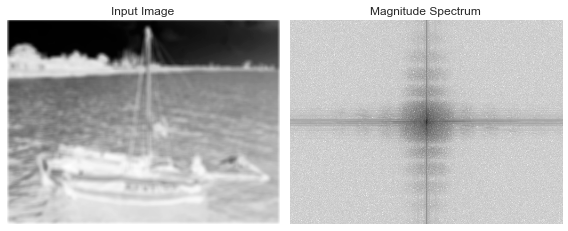

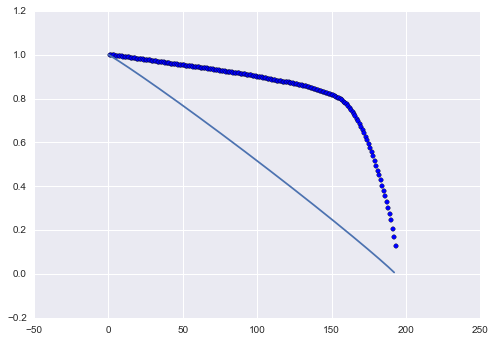

positive energy 0 negative energy 0.608036348855 delta_mean 0.99989827474 iqm 0.999999999741 eta 0 beta 0.29334725274 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


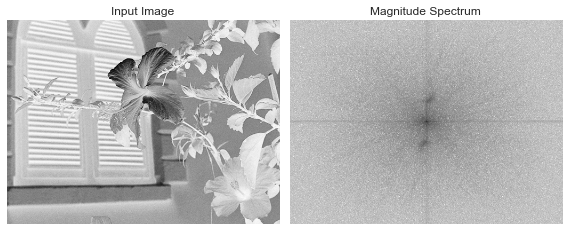

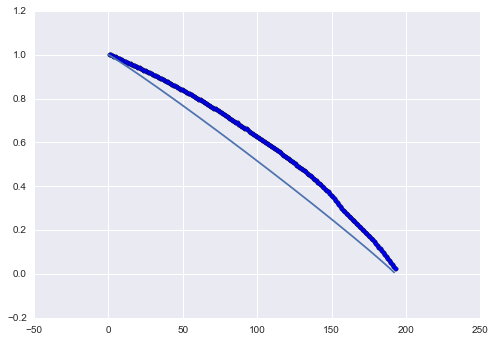

positive energy 0 negative energy 0.139701495734 delta_mean 0.999969482422 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


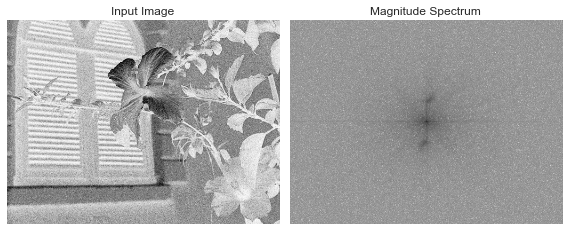

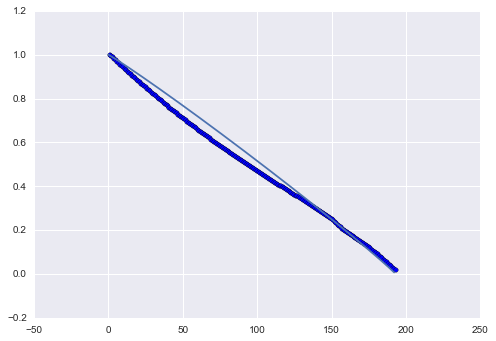

positive energy 0.0637464033045 negative energy 0.00184808851263 delta_mean 0.999913533529 iqm 0.421829015618 eta 0.481651125333 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


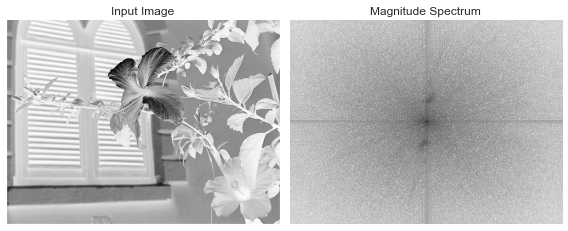

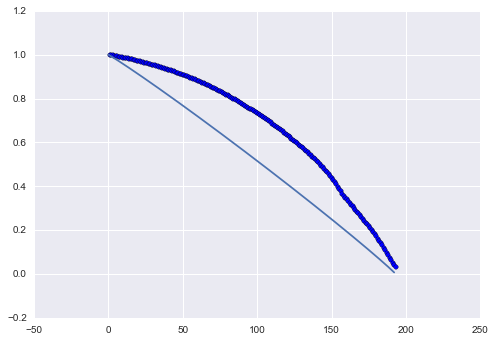

positive energy 0 negative energy 0.272417794823 delta_mean 0.999954223633 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


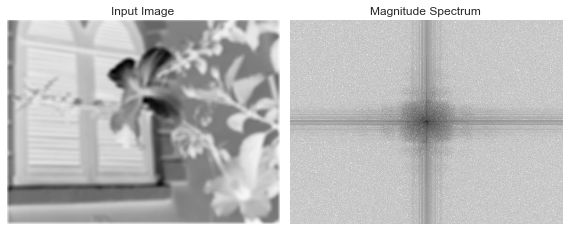

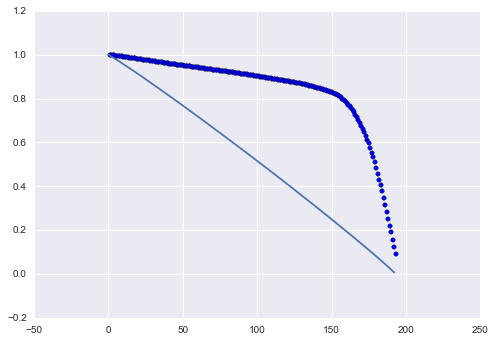

positive energy 0 negative energy 0.607518973428 delta_mean 0.999033610026 iqm 0.999999999935 eta 0 beta 0.271716970615 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


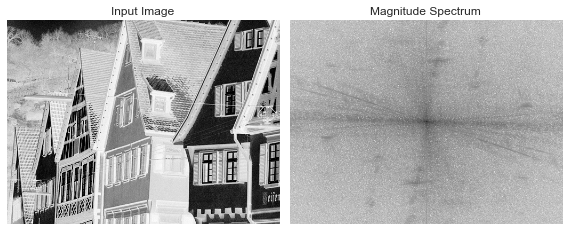

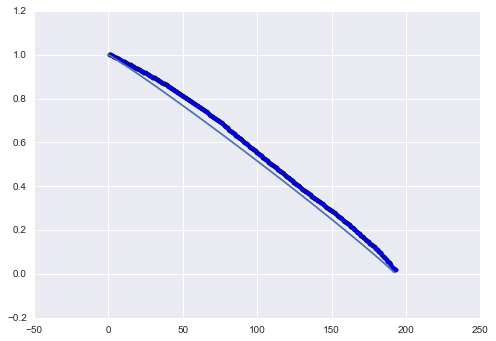

positive energy 0 negative energy 0.0561690702177 delta_mean 0.999638875326 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


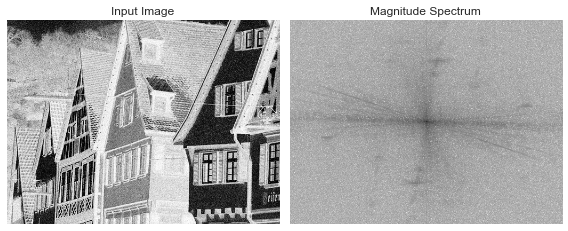

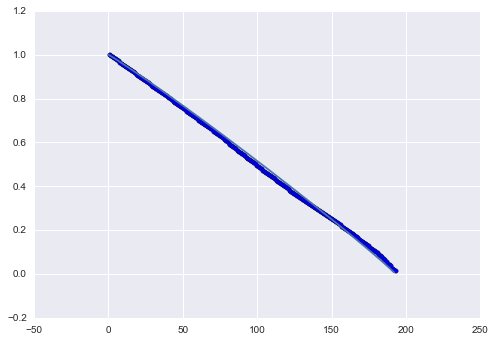

positive energy 0.0264340052273 negative energy 0.00297948689355 delta_mean 0.99973042806 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


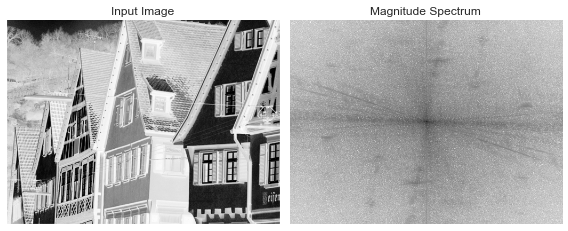

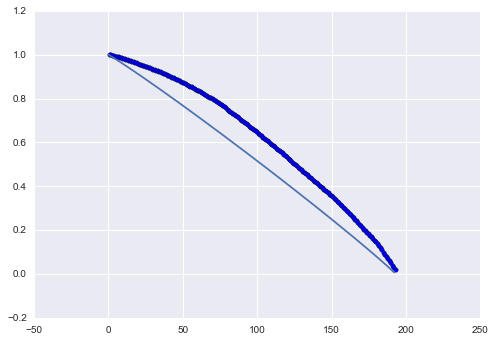

positive energy 0 negative energy 0.16869589212 delta_mean 0.999445597331 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


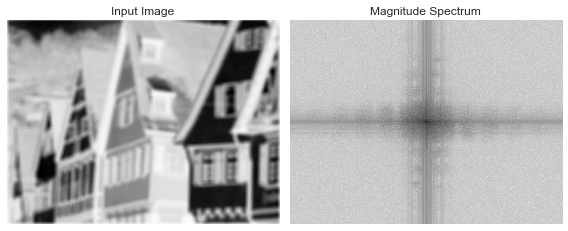

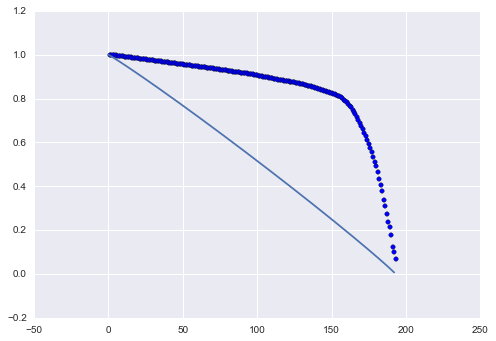

positive energy 0 negative energy 0.609667409353 delta_mean 0.999643961589 iqm 0.999999999396 eta 0 beta 0.307541731292 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


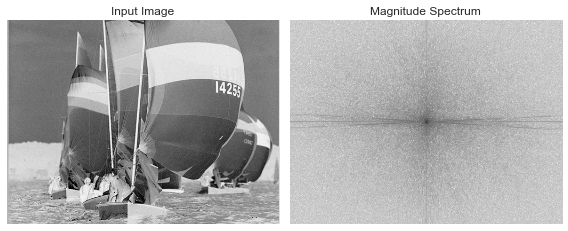

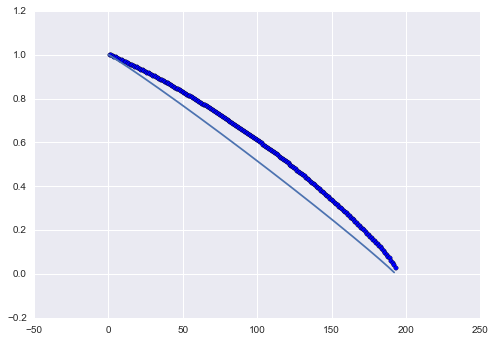

positive energy 0 negative energy 0.122649076408 delta_mean 0.999979654948 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


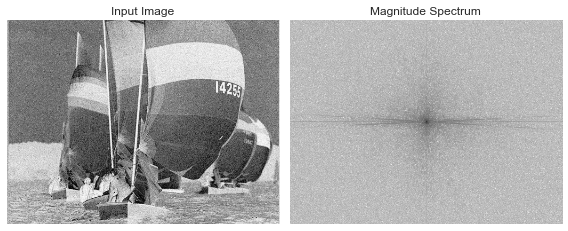

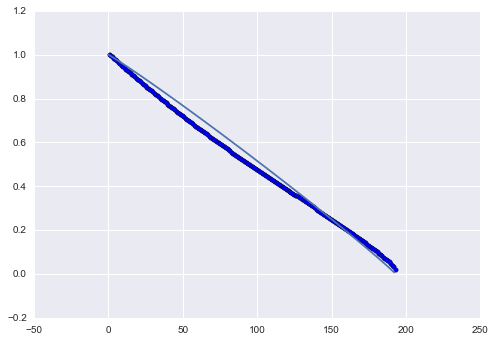

positive energy 0.0564294937004 negative energy 0.0043916000153 delta_mean 0.999969482422 iqm 0.383382159059 eta 0.524829937492 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


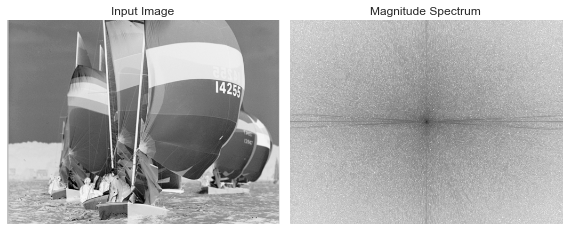

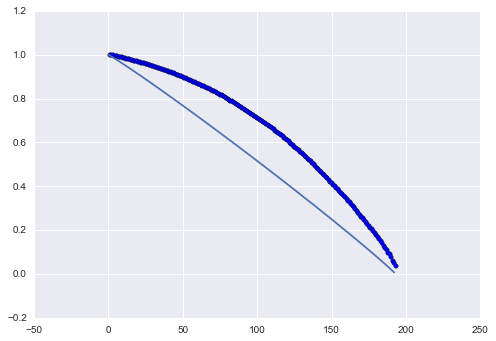

positive energy 0 negative energy 0.251613029005 delta_mean 0.99994913737 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


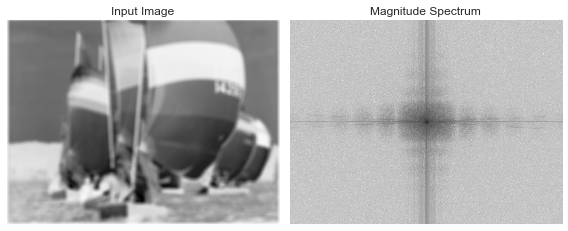

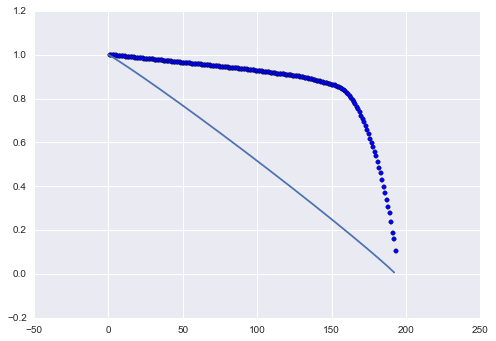

positive energy 0 negative energy 0.653460173307 delta_mean 0.997355143229 iqm 0.999999999972 eta 0 beta 0.259610802236 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


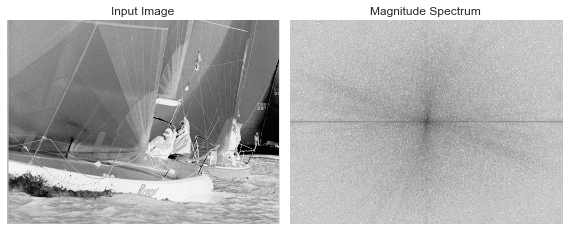

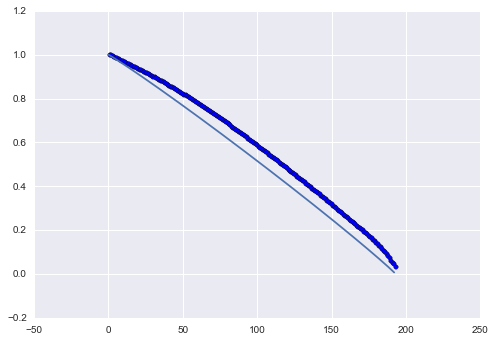

positive energy 0 negative energy 0.0978500955341 delta_mean 0.999944051107 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


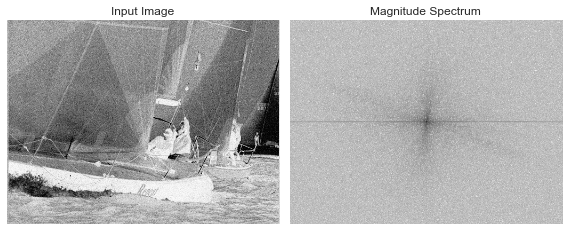

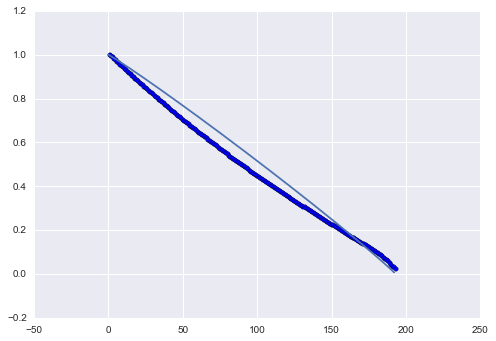

positive energy 0.0871953207034 negative energy 0.00293492177687 delta_mean 0.999933878581 iqm 0.411201756588 eta 0.493494042308 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


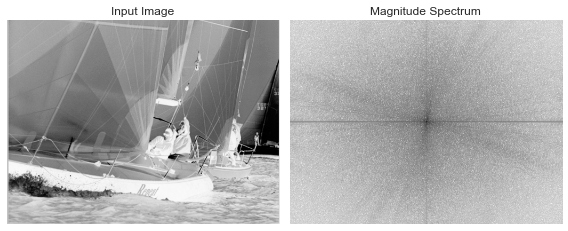

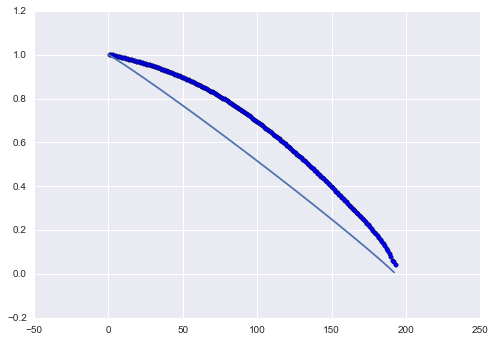

positive energy 0 negative energy 0.232589688196 delta_mean 0.999979654948 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


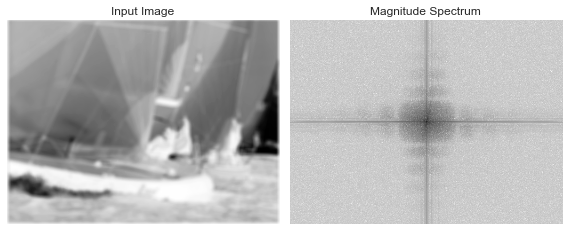

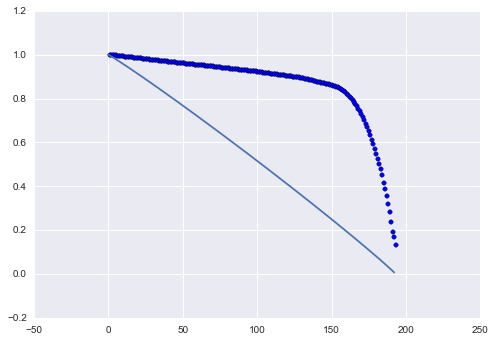

positive energy 0 negative energy 0.651634694447 delta_mean 0.996643066406 iqm 0.999999999999 eta 0 beta 0.21971697685 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


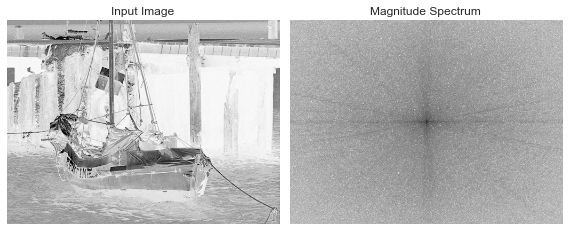

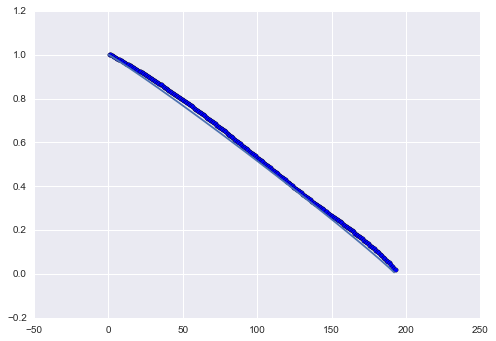

positive energy 0 negative energy 0.0249948309245 delta_mean 0.999979654948 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


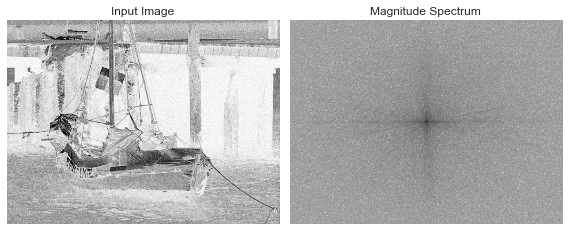

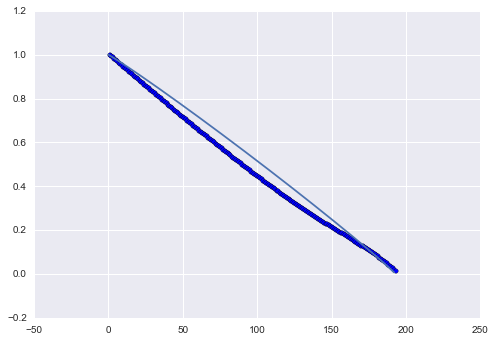

positive energy 0.0869568611173 negative energy 0.000516751719787 delta_mean 0.999944051107 iqm 0.411062695311 eta 0.493650636864 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


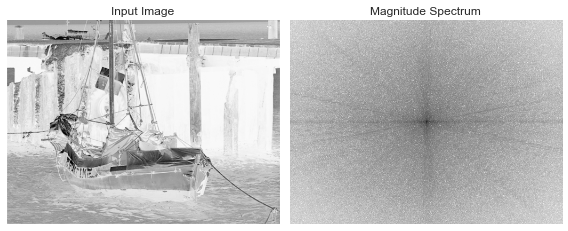

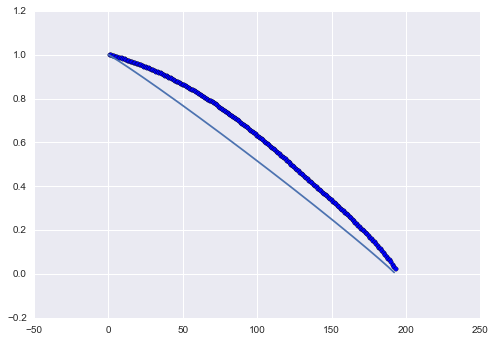

positive energy 0 negative energy 0.14864231476 delta_mean 0.999872843424 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


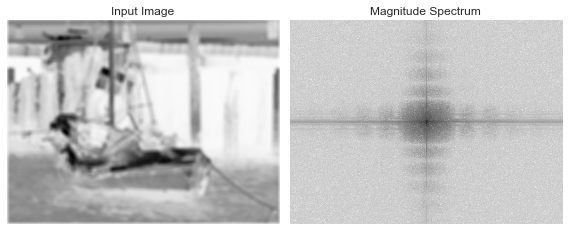

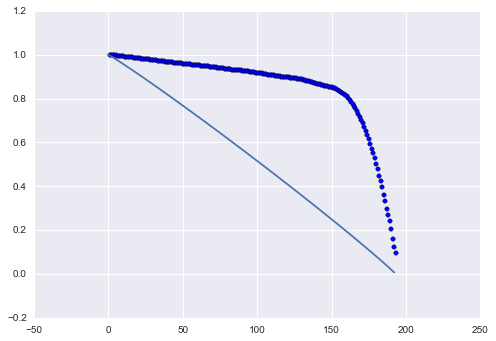

positive energy 0 negative energy 0.633419564846 delta_mean 0.999816894531 iqm 0.999999998961 eta 0 beta 0.316920433515 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


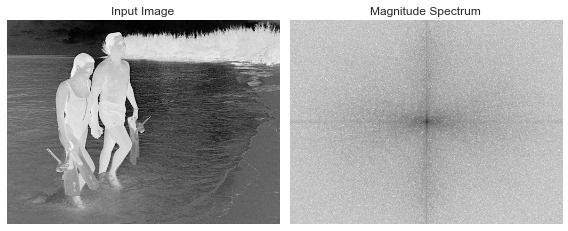

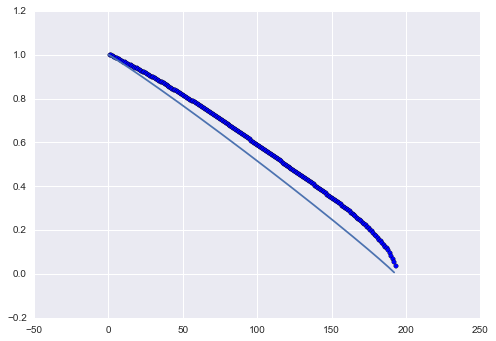

positive energy 0 negative energy 0.115659305068 delta_mean 0.999735514323 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


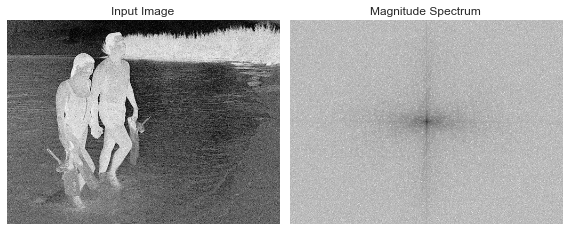

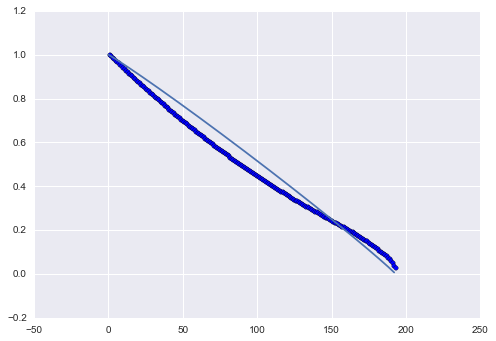

positive energy 0.0850868111987 negative energy 0.00836897450296 delta_mean 0.99983215332 iqm 0.430889746707 eta 0.471603424951 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


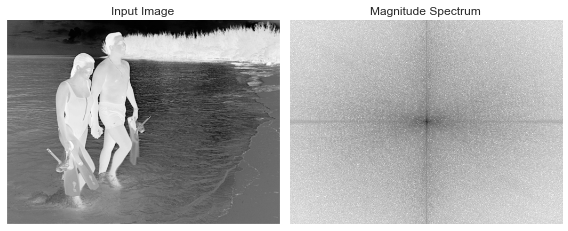

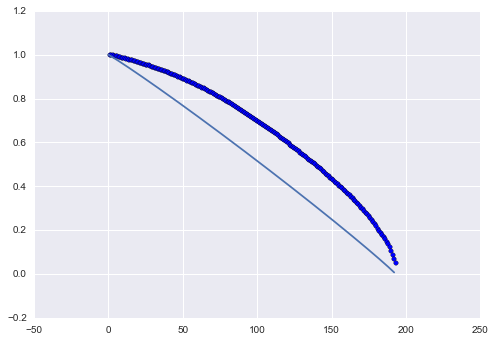

positive energy 0 negative energy 0.256867394916 delta_mean 0.999816894531 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


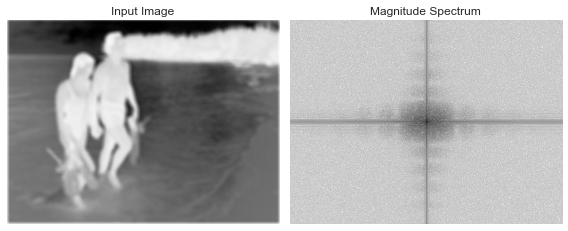

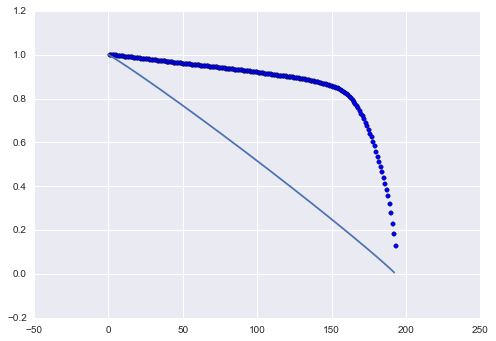

positive energy 0 negative energy 0.651667582612 delta_mean 0.997451782227 iqm 0.999999999952 eta 0 beta 0.267413035933 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


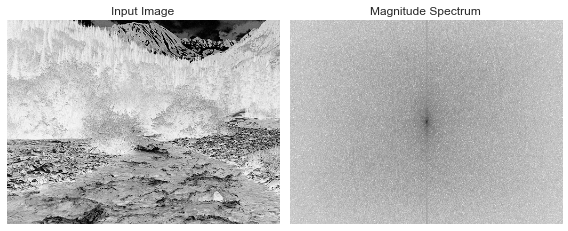

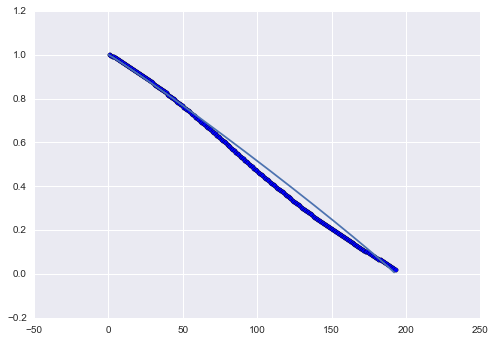

positive energy 0.0538032994993 negative energy 0.000428554475299 delta_mean 0.999654134115 iqm 0.417448051836 eta 0.486493231217 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


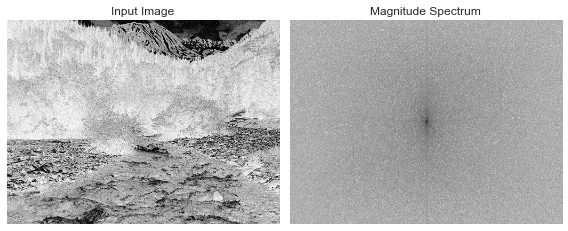

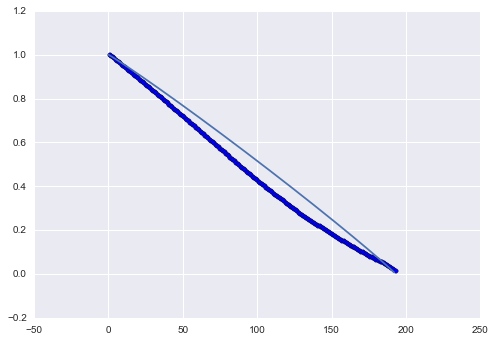

positive energy 0.110938385854 negative energy 0.000198497066213 delta_mean 0.999659220378 iqm 0.422088605577 eta 0.48133296307 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


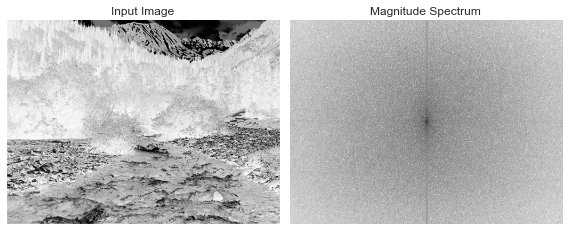

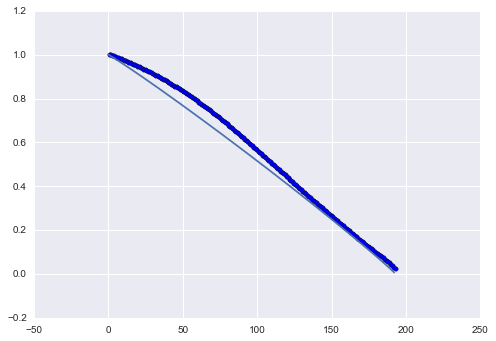

positive energy 0 negative energy 0.0608948734742 delta_mean 0.999643961589 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


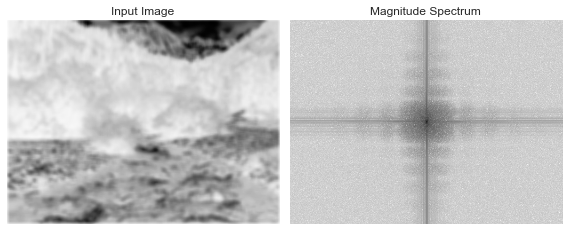

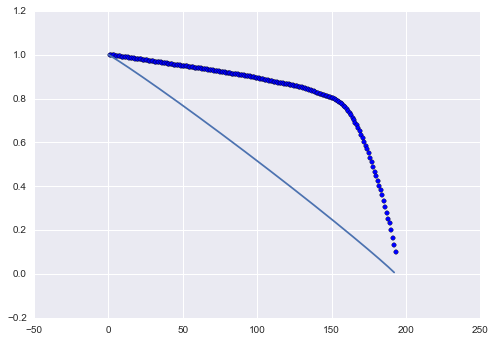

positive energy 0 negative energy 0.585477886581 delta_mean 0.998692830404 iqm 0.999999999934 eta 0 beta 0.272160668467 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


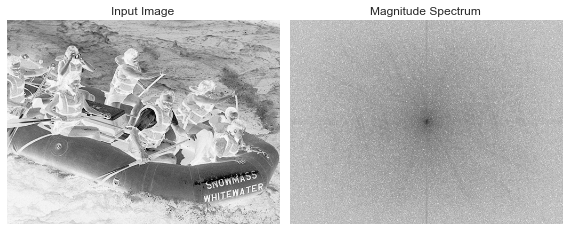

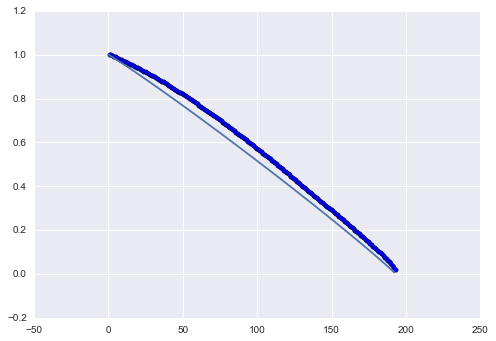

positive energy 0 negative energy 0.0704506473757 delta_mean 0.999964396159 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


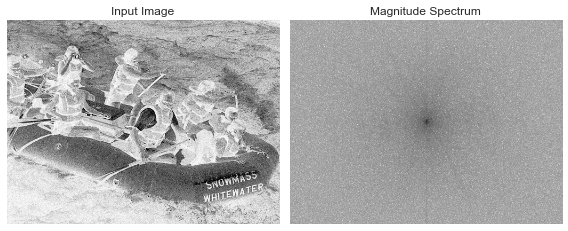

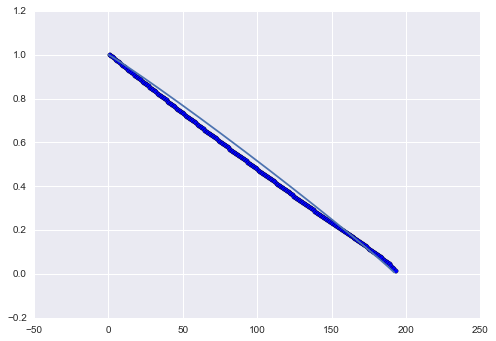

positive energy 0.0532624352298 negative energy 0.00126091840456 delta_mean 0.999877929688 iqm 0.374572739212 eta 0.534840990285 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


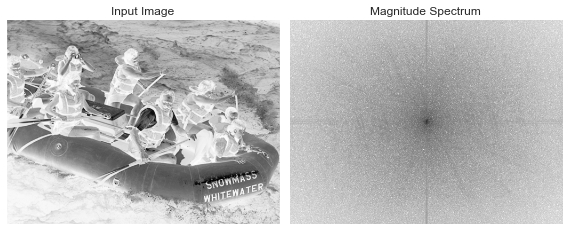

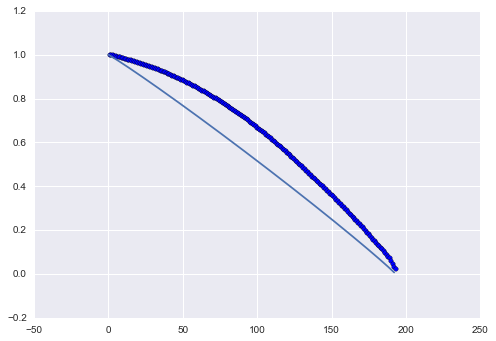

positive energy 0 negative energy 0.189107849631 delta_mean 0.999933878581 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


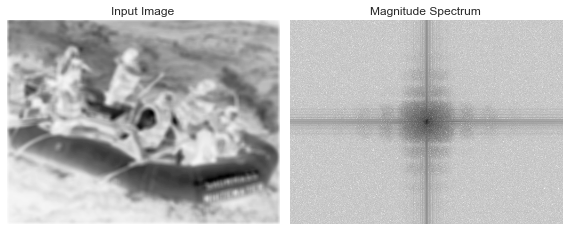

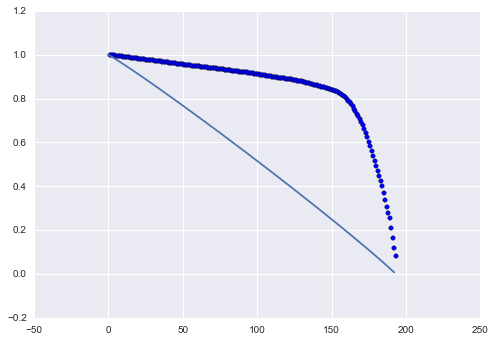

positive energy 0 negative energy 0.623587377106 delta_mean 0.9990234375 iqm 0.999999999823 eta 0 beta 0.287314732869 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


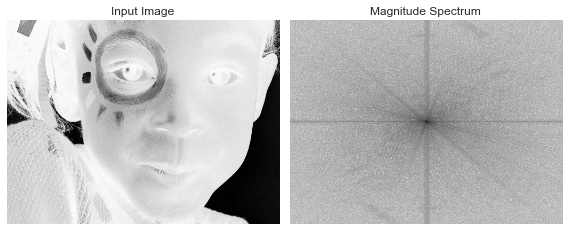

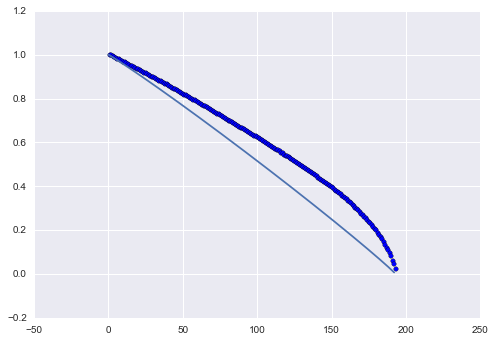

positive energy 0 negative energy 0.158590177244 delta_mean 0.99994913737 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


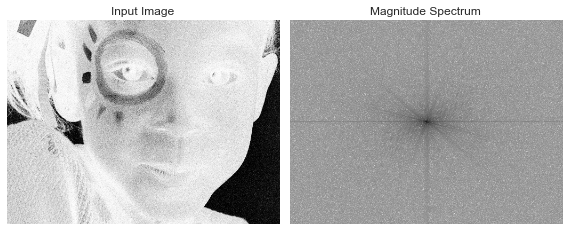

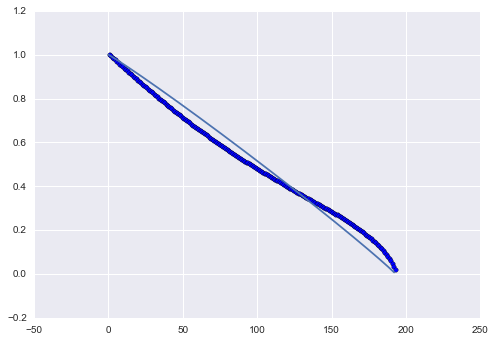

positive energy 0.0531513119198 negative energy 0.021081243993 delta_mean 0.999867757161 iqm 0.422390473578 eta 0.481022198995 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


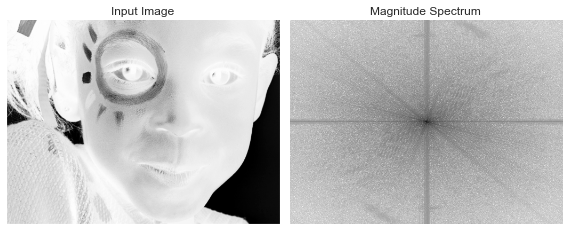

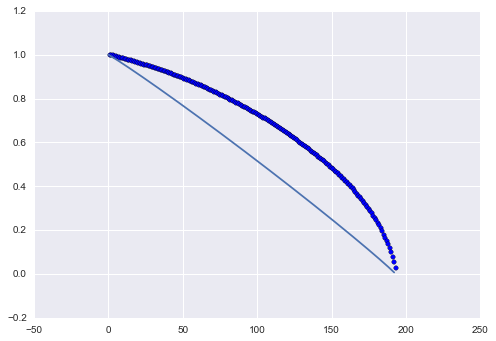

positive energy 0 negative energy 0.297250589066 delta_mean 0.999944051107 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


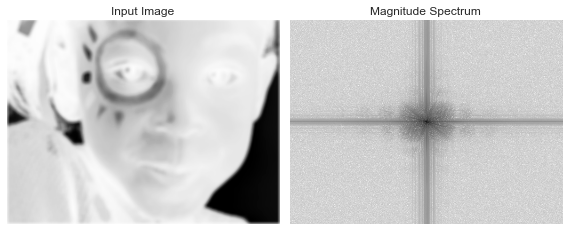

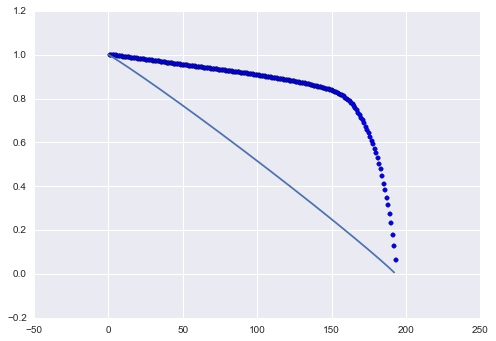

positive energy 0 negative energy 0.628084777376 delta_mean 0.999816894531 iqm 0.99999999966 eta 0 beta 0.297859163948 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


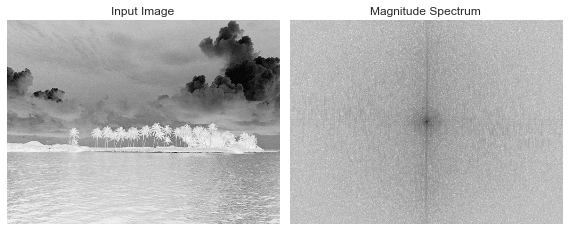

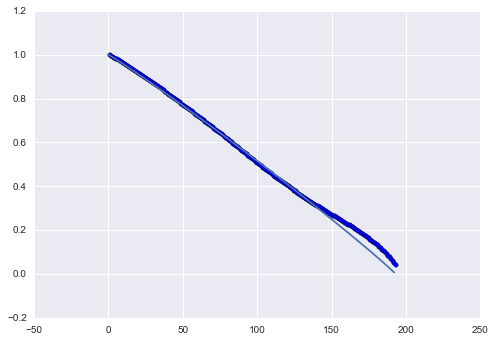

positive energy 0.00700317008124 negative energy 0.0177958587021 delta_mean 0.999969482422 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


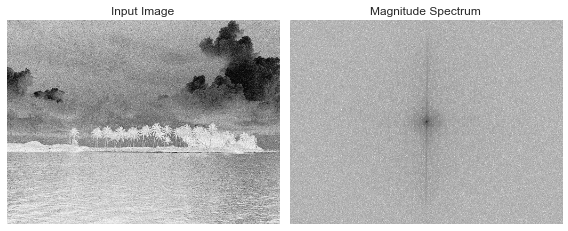

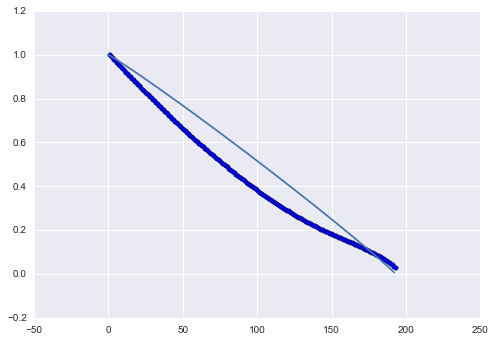

positive energy 0.162521082108 negative energy 0.00169469883999 delta_mean 0.999954223633 iqm 0.353604816553 eta 0.558890799233 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


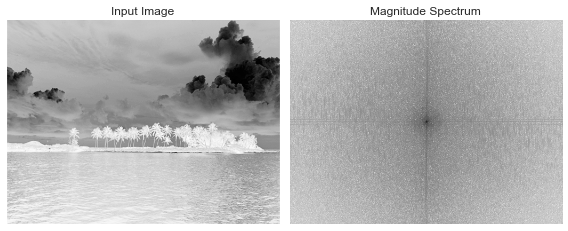

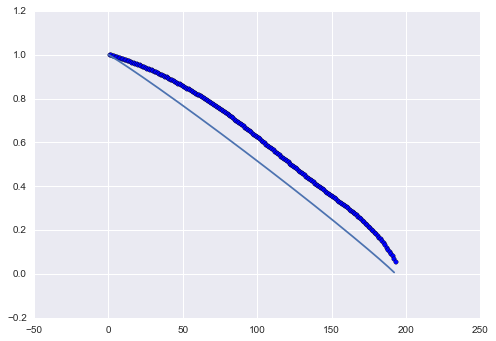

positive energy 0 negative energy 0.160789733609 delta_mean 0.999979654948 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


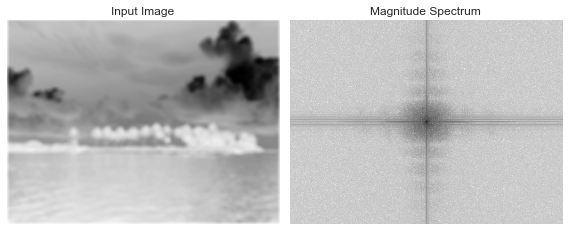

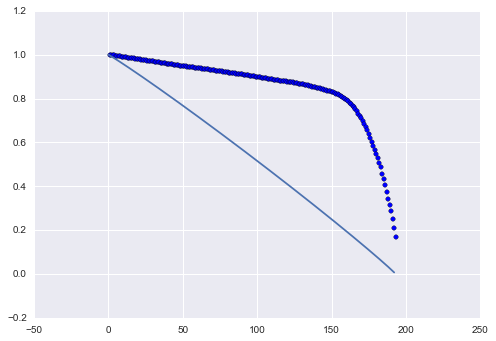

positive energy 0 negative energy 0.623247640919 delta_mean 0.998204549154 iqm 0.999999999996 eta 0 beta 0.23351822268 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


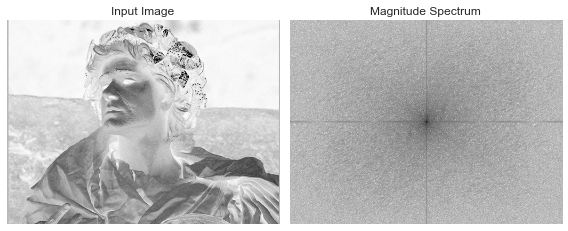

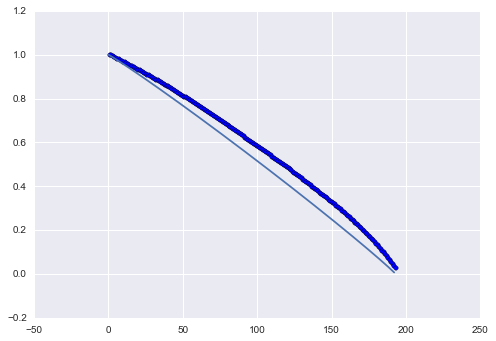

positive energy 0 negative energy 0.0951853927708 delta_mean 0.999908447266 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


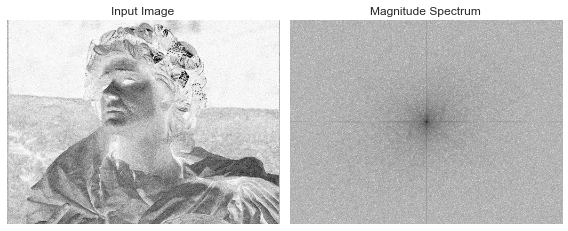

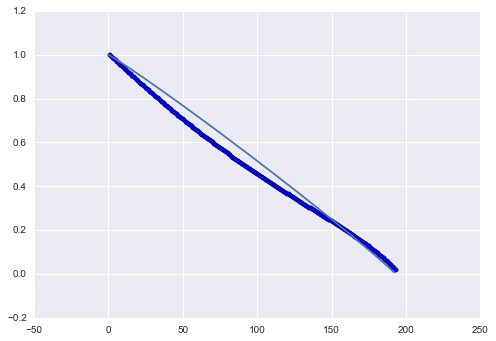

positive energy 0.0766452003384 negative energy 0.00323530271924 delta_mean 0.999928792318 iqm 0.389431834037 eta 0.517970979754 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


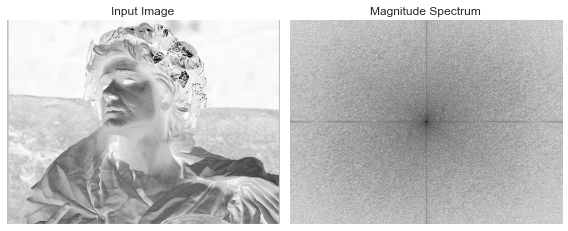

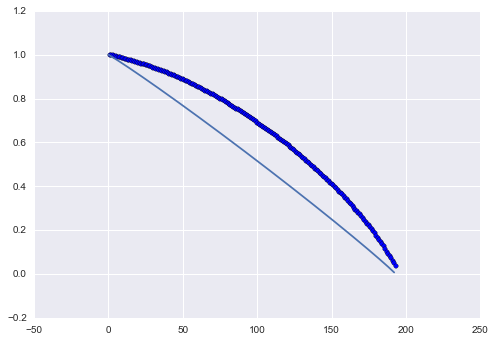

positive energy 0 negative energy 0.231347302615 delta_mean 0.999923706055 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


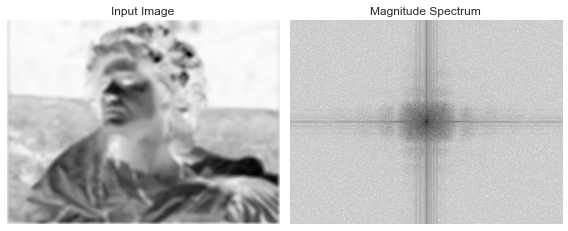

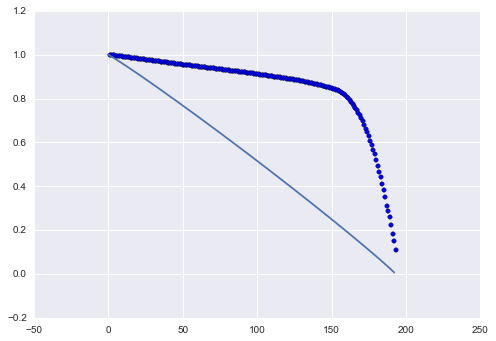

positive energy 0 negative energy 0.630709885924 delta_mean 0.996795654297 iqm 0.999999999989 eta 0 beta 0.246873554431 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


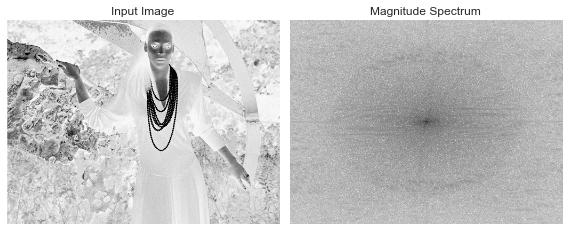

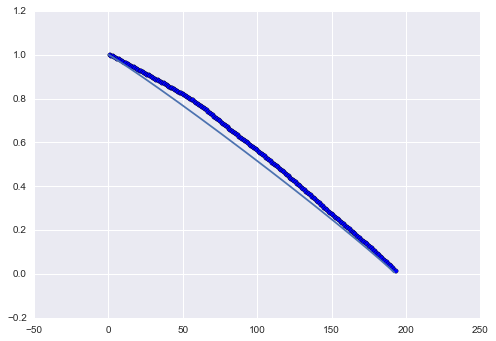

positive energy 0 negative energy 0.0553492491813 delta_mean 0.999547322591 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


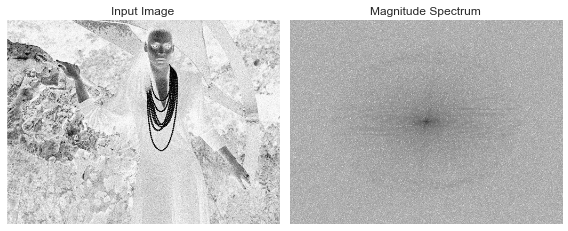

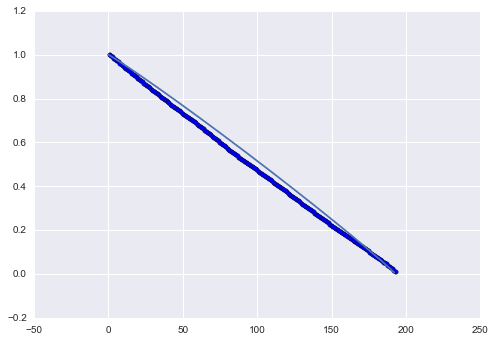

positive energy 0.063951876055 negative energy 8.44238690528e-05 delta_mean 0.999450683594 iqm 0.51193480902 eta 0.384203258414 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


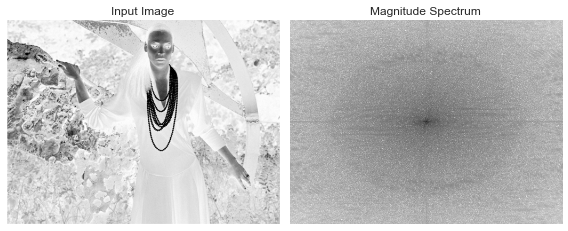

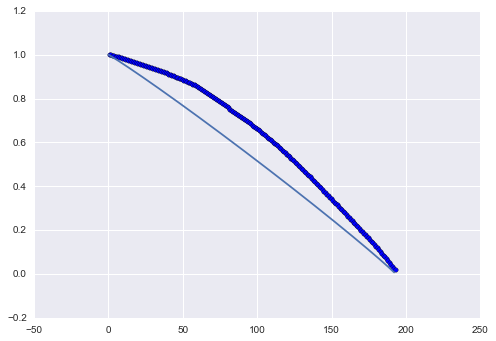

positive energy 0 negative energy 0.173362353958 delta_mean 0.999481201172 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


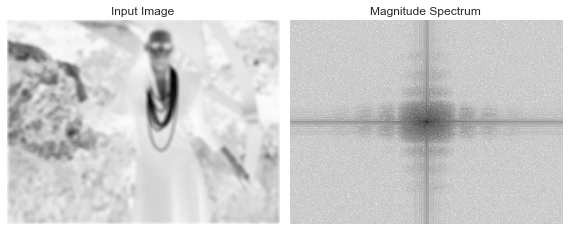

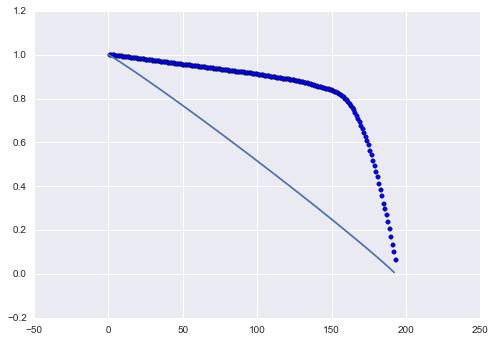

positive energy 0 negative energy 0.613328555121 delta_mean 0.998718261719 iqm 0.999999999963 eta 0 beta 0.263563645993 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


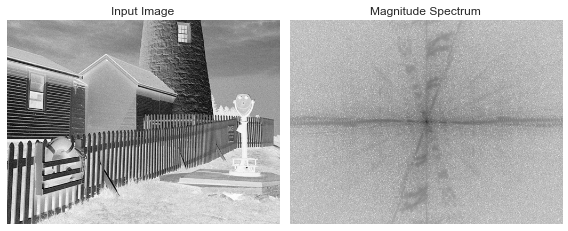

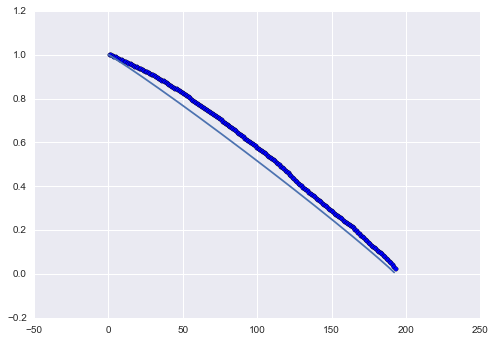

positive energy 0 negative energy 0.0748830089027 delta_mean 0.999913533529 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


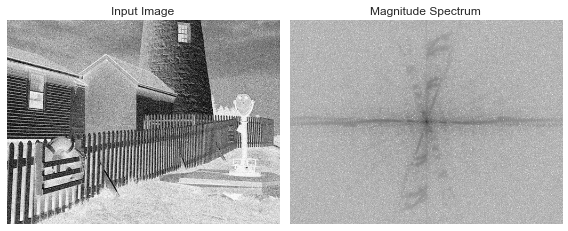

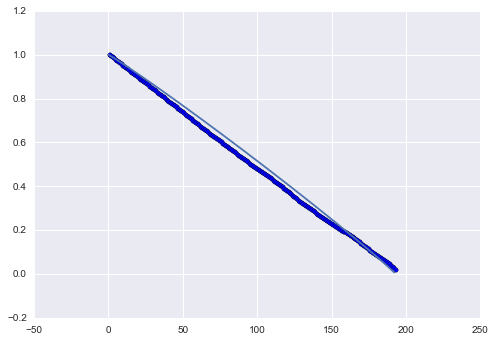

positive energy 0.0518704180101 negative energy 0.00121566031997 delta_mean 0.999801635742 iqm 0.413088421896 eta 0.491371350861 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


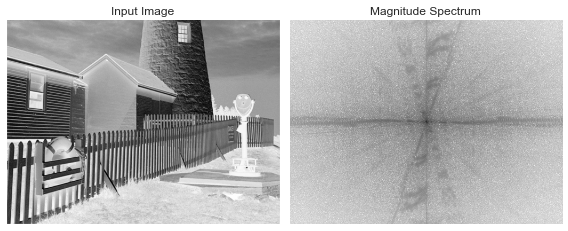

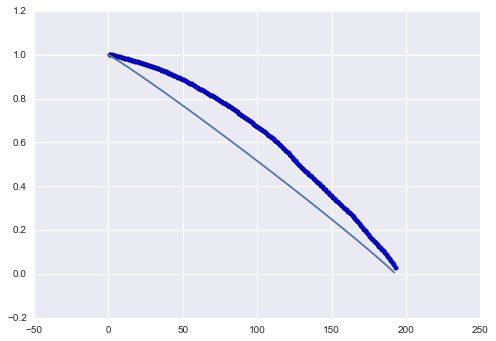

positive energy 0 negative energy 0.190474171898 delta_mean 0.999918619792 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


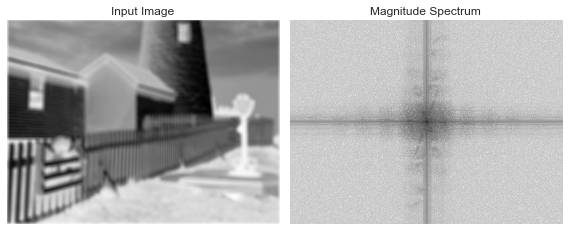

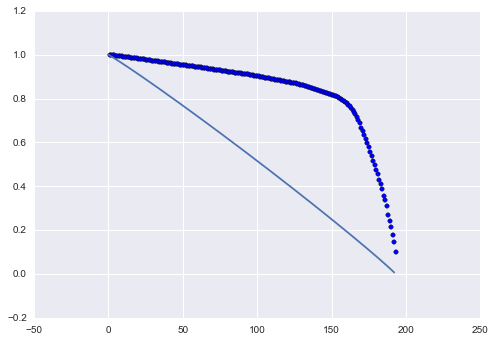

positive energy 0 negative energy 0.605847003109 delta_mean 0.999404907227 iqm 0.999999999367 eta 0 beta 0.308375244141 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


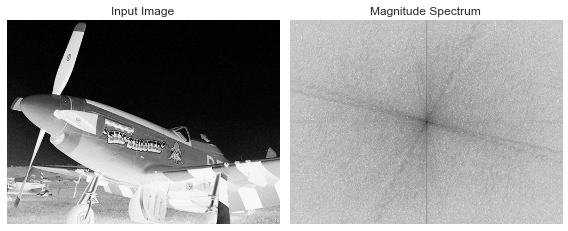

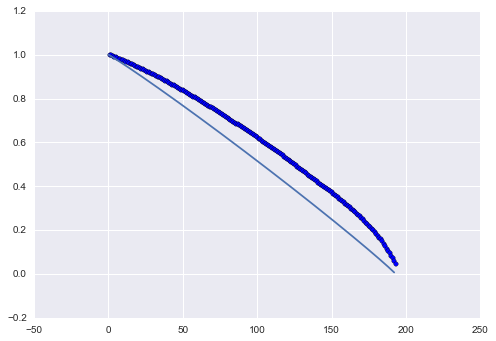

positive energy 0 negative energy 0.154441815028 delta_mean 0.999745686849 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


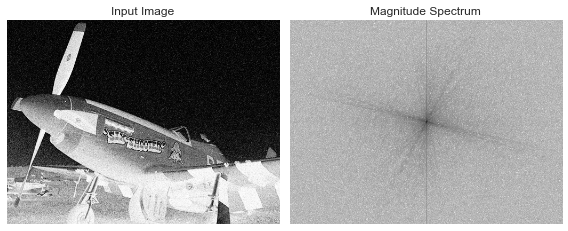

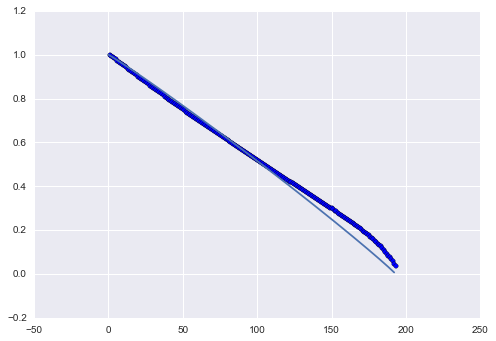

positive energy 0.0149291561708 negative energy 0.0319758979477 delta_mean 0.999399820964 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


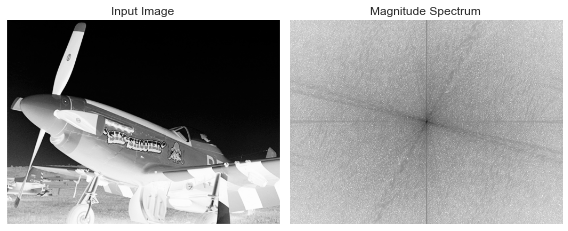

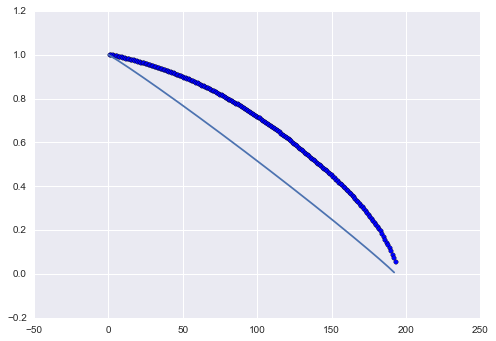

positive energy 0 negative energy 0.276917025275 delta_mean 0.999791463216 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


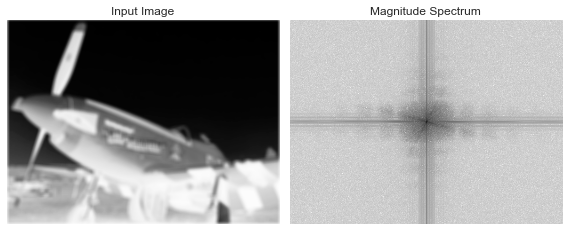

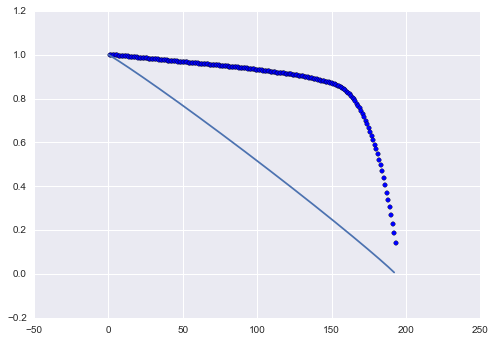

positive energy 0 negative energy 0.667723536364 delta_mean 0.999847412109 iqm 0.999999999738 eta 0 beta 0.293583605025 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


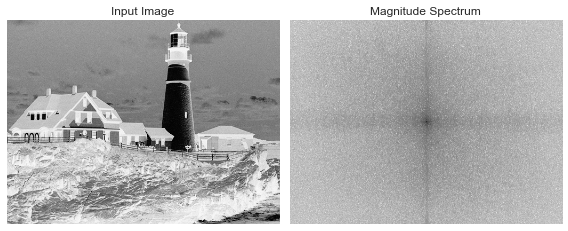

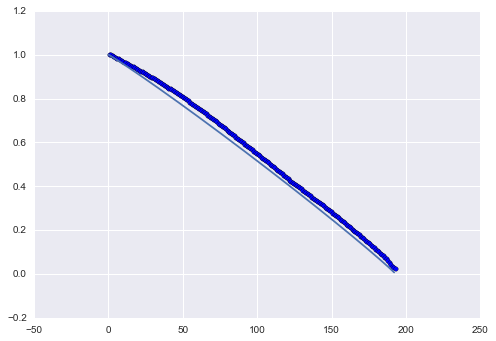

positive energy 0 negative energy 0.0462693582225 delta_mean 0.999857584635 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


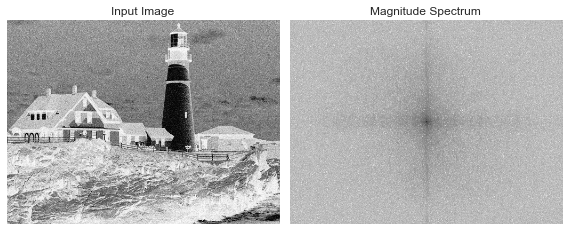

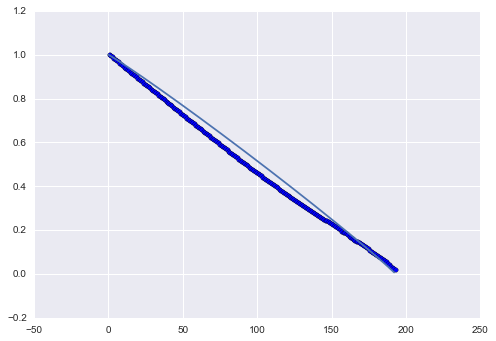

positive energy 0.0699017676812 negative energy 0.000914126787111 delta_mean 0.999913533529 iqm 0.38824429768 eta 0.519312966364 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


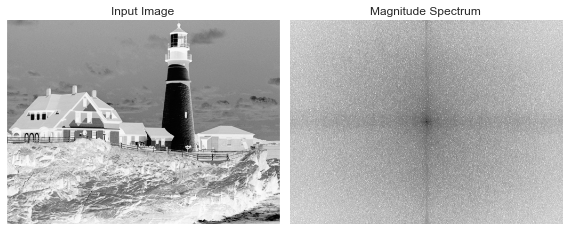

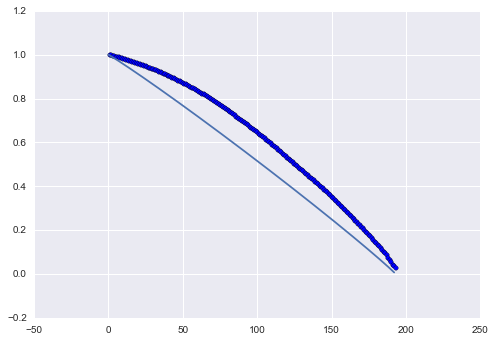

positive energy 0 negative energy 0.167558146752 delta_mean 0.999964396159 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


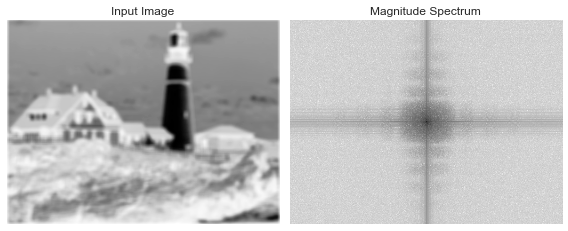

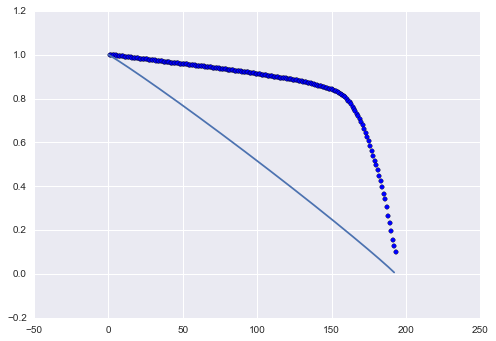

positive energy 0 negative energy 0.625239796174 delta_mean 0.998331705729 iqm 0.999999999974 eta 0 beta 0.258403674976 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


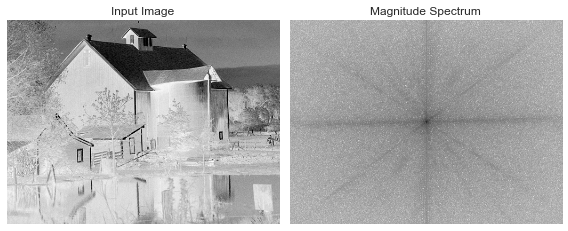

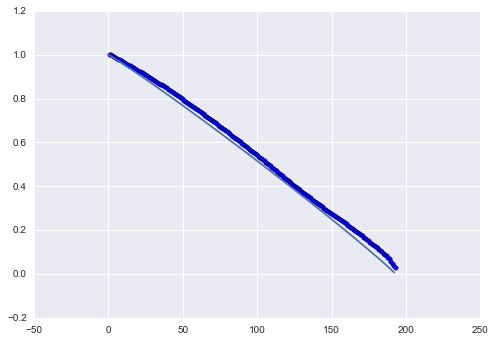

positive energy 0 negative energy 0.0380771002543 delta_mean 0.999923706055 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


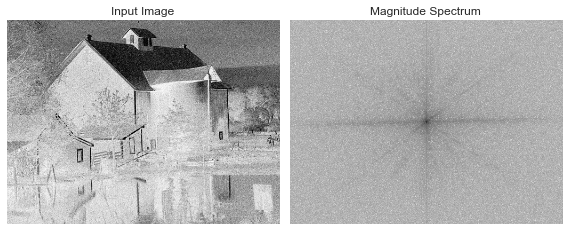

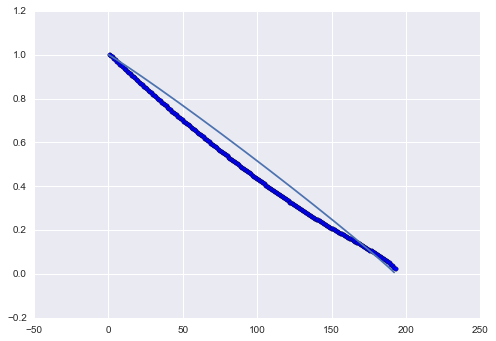

positive energy 0.104152251474 negative energy 0.00174415076392 delta_mean 0.999852498372 iqm 0.422769302382 eta 0.480599793391 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


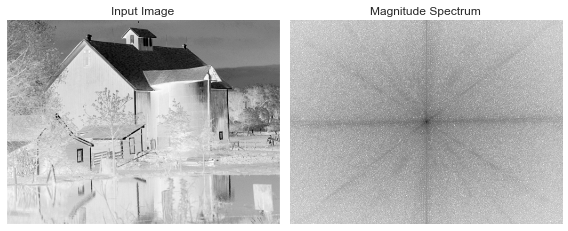

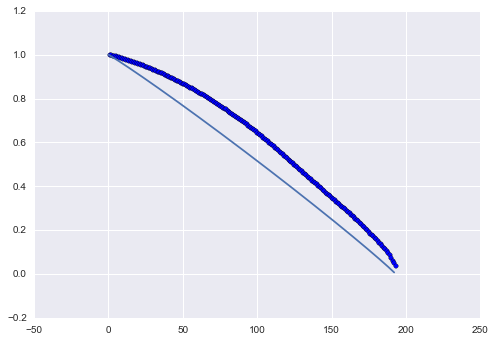

positive energy 0 negative energy 0.168002649744 delta_mean 0.999918619792 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


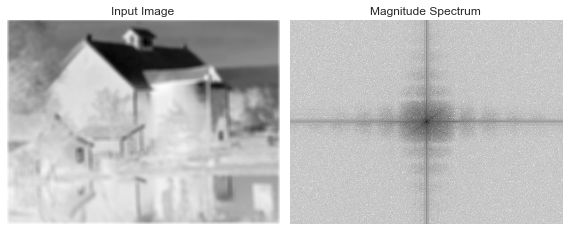

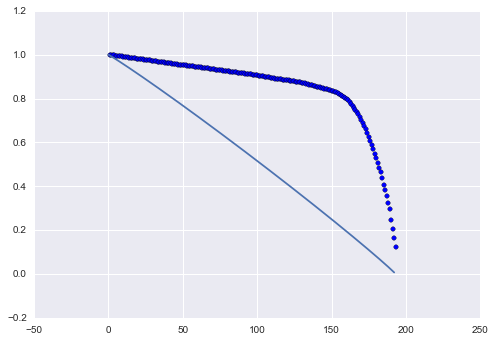

positive energy 0 negative energy 0.625211114899 delta_mean 0.999476114909 iqm 0.999999999818 eta 0 beta 0.28774184777 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


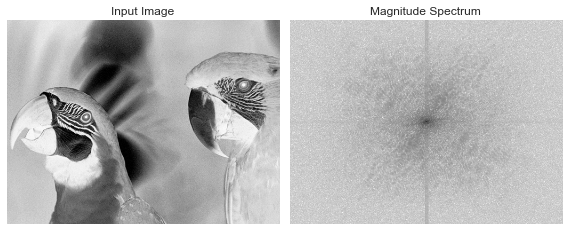

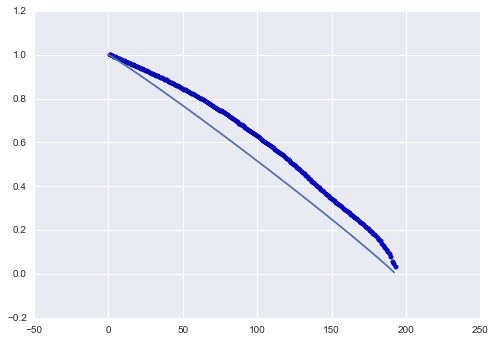

positive energy 0 negative energy 0.148216590221 delta_mean 0.999918619792 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


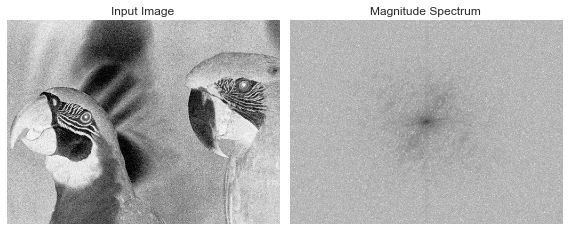

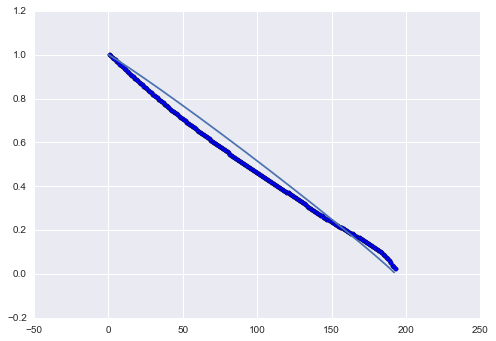

positive energy 0.07418502213 negative energy 0.00624881305063 delta_mean 0.999984741211 iqm 0.360357936267 eta 0.551122368707 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


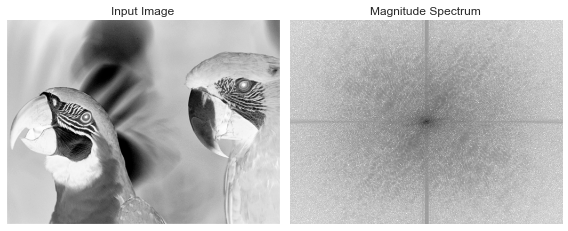

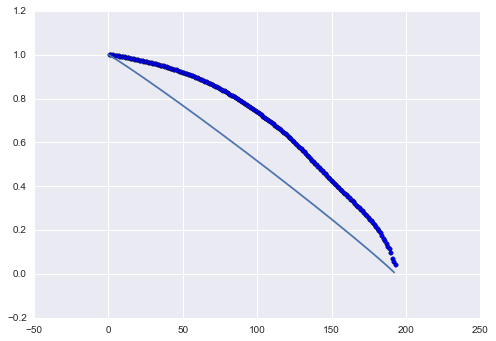

positive energy 0 negative energy 0.28737352415 delta_mean 0.999923706055 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


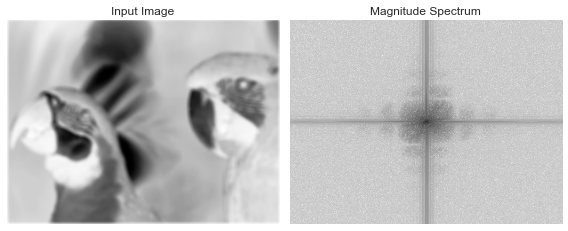

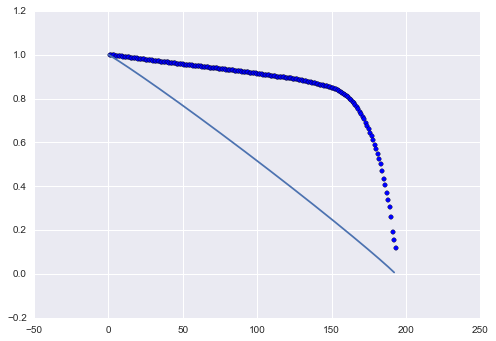

positive energy 0 negative energy 0.643287873304 delta_mean 0.998387654622 iqm 0.999999999964 eta 0 beta 0.263272485978 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


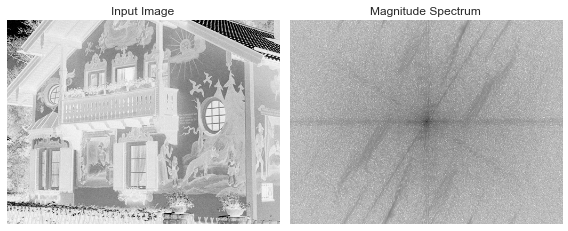

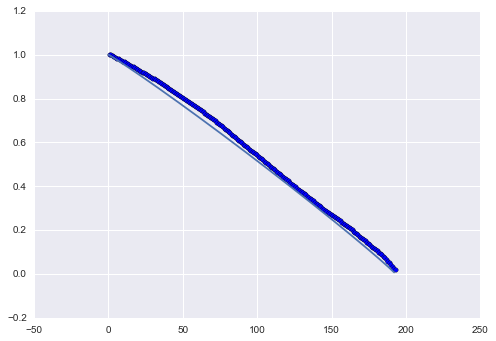

positive energy 0 negative energy 0.0372655149535 delta_mean 0.999959309896 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


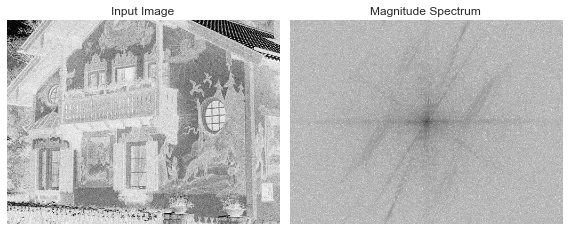

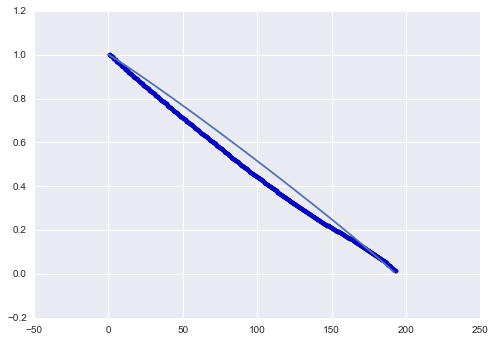

positive energy 0.0938801742645 negative energy 0.000477068894596 delta_mean 0.99967956543 iqm 0.471259149599 eta 0.427514715561 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


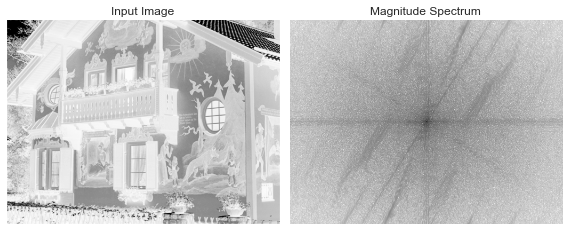

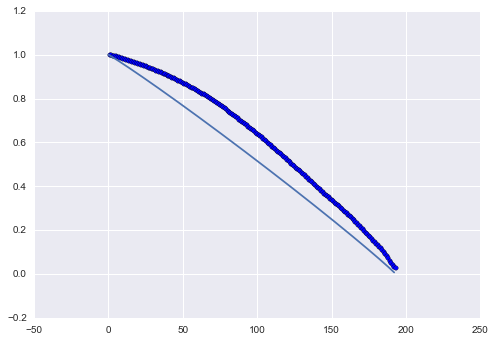

positive energy 0 negative energy 0.158619035034 delta_mean 0.999893188477 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


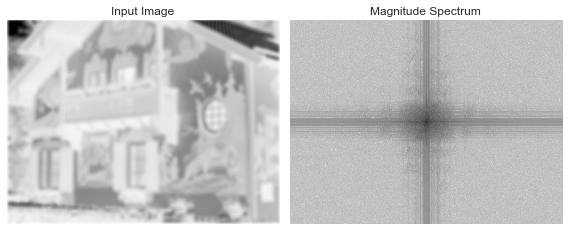

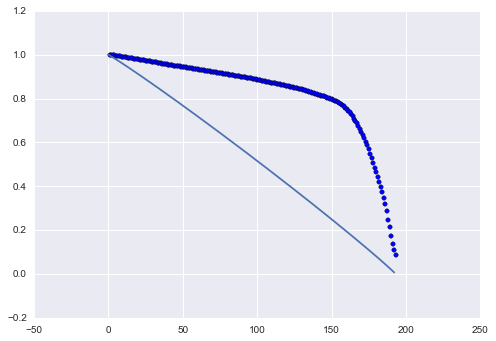

positive energy 0 negative energy 0.579118209328 delta_mean 0.999816894531 iqm 0.999999999807 eta 0 beta 0.288597954644 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


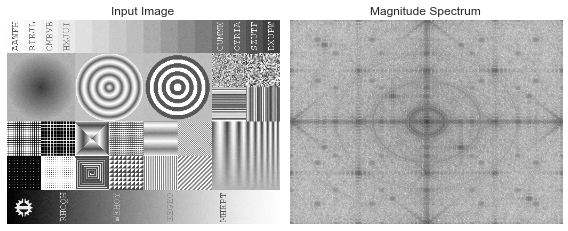

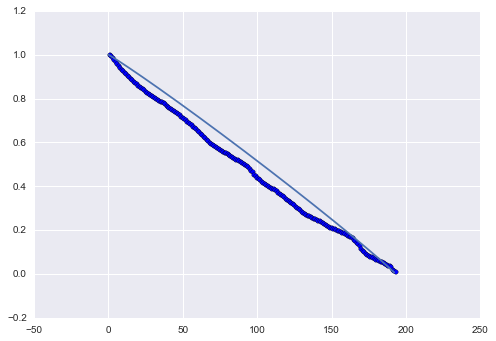

positive energy 0.105091788438 negative energy 8.26762619716e-05 delta_mean 0.998845418294 iqm 0.403022259392 eta 0.50253059382 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


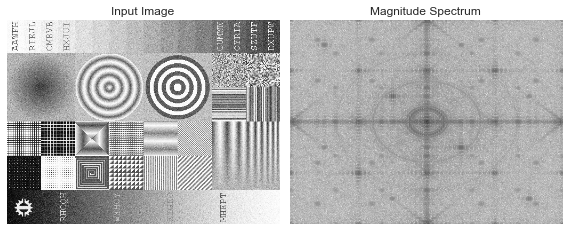

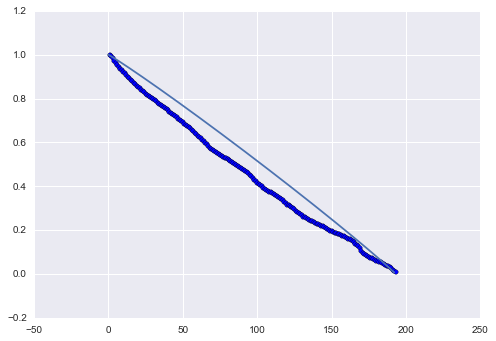

positive energy 0.133470630562 negative energy 4.05011168549e-05 delta_mean 0.998840332031 iqm 0.404828036132 eta 0.50050346782 beta 0 type gaussian 

Image shape (384, 512) Fourier shape (384, 512, 2)


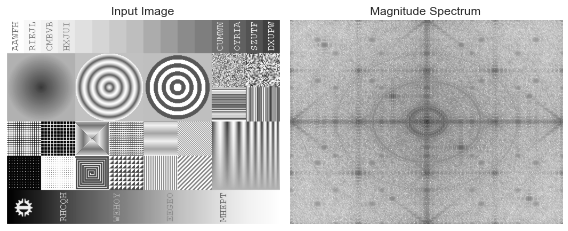

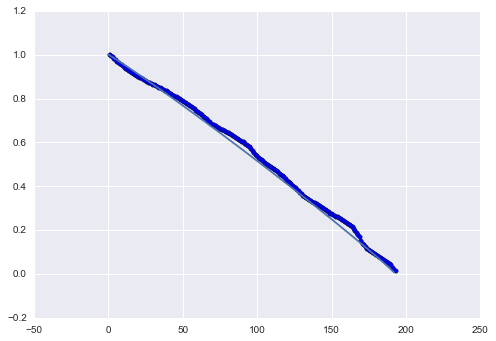

positive energy 0.00414376139615 negative energy 0.0226212654812 delta_mean 0.99885559082 iqm 1.0 eta 0 beta 0 type  

Image shape (384, 512) Fourier shape (384, 512, 2)


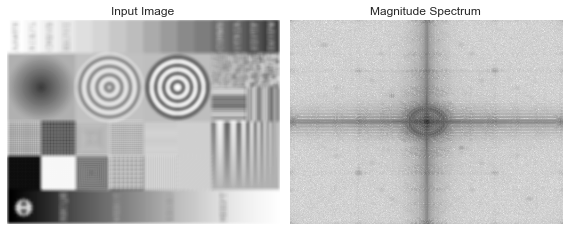

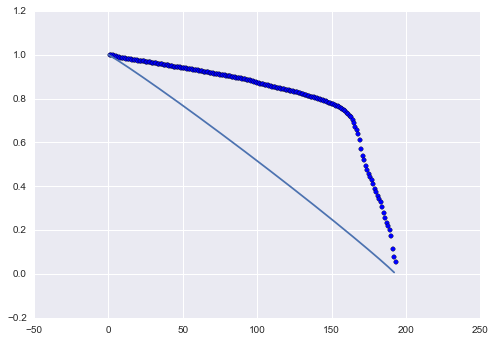

positive energy 0 negative energy 0.543454431577 delta_mean 0.999547322591 iqm 0.999999802272 eta 0 beta 0.424243878096 type  



In [306]:
filt = np.in1d(distortions["level"].values, [1, 5]) & np.in1d(distortions["type"].values, ["01", "08"])
quality_scores = np.vectorize(fft_based_quality)(X[filt], verbose=True)

max 332.0 min -275.0 mean -0.00151570638021 Sd 21.459823987


(0.0, 126.79429782435226, 255.0, 14, 98.751307169596359, 255)

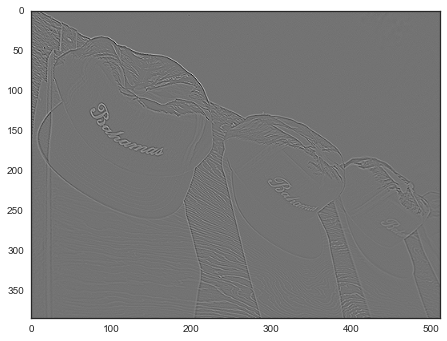

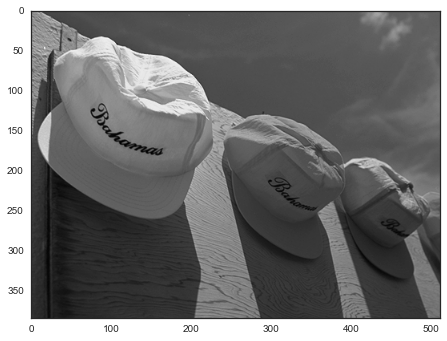

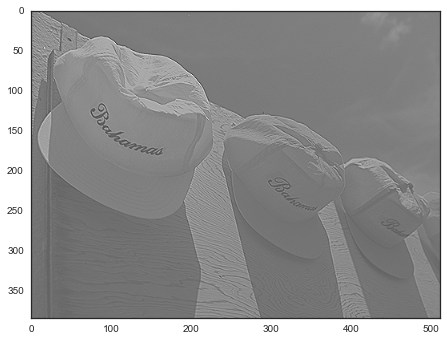

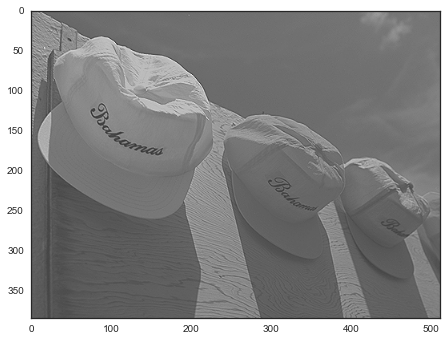

In [241]:
sns.set_style("white")
img = "/Users/alfiya/Documents/work/Image Quality/tid2013/reference_images/i03.bmp"

img = cv2.imread(img, 0)
laplacian = cv2.Laplacian(img, cv2.CV_64F)
print "max", laplacian.max(), "min", laplacian.min(), "mean", laplacian.mean(), "Sd", laplacian.std()
plt.imshow(laplacian, cmap='gray')

laplacian_scaled = (laplacian - laplacian.min())*255 / (laplacian.max() - laplacian.min())
# laplacian_scaled = laplacian_scaled * (img.max() - img.min()) + img.min()

# threshold = 32
# plt.figure()
# plt.imshow(laplacian > threshold, cmap='gray')

# delta = np.zeros(laplacian.shape)
# block_size = (8, 8)
# i_step = block_size[0]
# j_step = block_size[1]
# denom = float(block_size[0]) * block_size[1]
# for i in np.arange(0, img.shape[0], i_step):
#     for j in np.arange(0, img.shape[1], j_step):
#         delta[i:i + i_step, j:j + j_step] =\
#             (laplacian[i:i + i_step, j:j + j_step] > threshold).sum() / denom
# plt.figure()
# plt.imshow(delta, cmap='gray')

plt.figure()
plt.imshow(img, cmap='gray')
plt.figure()
sharpened = img - laplacian
sharpened = (sharpened - sharpened.min())*255 / (sharpened.max() - sharpened.min())
plt.imshow(sharpened, cmap='gray')
plt.figure()
plt.imshow(img - laplacian_scaled, cmap='gray')

(sharpened).min(), (sharpened).mean(), (sharpened).max(), img.min(), img.mean(), img.max()

(512, 512)
('Image shape', (512, 512), 'Fourier shape', (512, 512, 2))
('Image mean', 112.20343399047852, 'Image max', 235)
('Comp 1 min, mean, max', 229.99997, -1548441.8, 29413456.0)
('Comp 2 min, mean, max', 0.0, -2885554.8, 2885554.8)
('Magnitude mean, min, max', 94.487556, 0.0, 255.0)


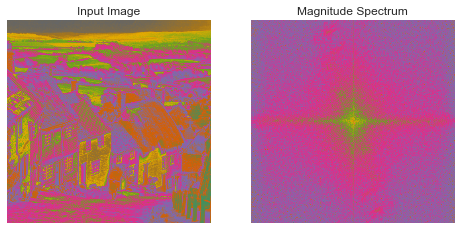

('Image shape', (512, 512), 'Fourier shape', (512, 512, 2))
('Image mean', 126.19435882568359, 'Image max', 255)
('Comp 1 min, mean, max', 116.00003, -988702.75, 33081094.0)
('Comp 2 min, mean, max', 0.0, -1496160.2, 1496160.2)
('Magnitude mean, min, max', 114.82928, 0.0, 255.0)


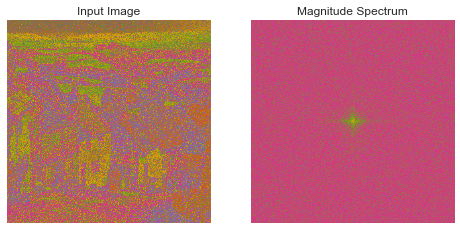

('Image shape', (512, 512), 'Fourier shape', (512, 512, 2))
('Image mean', 112.20857238769531, 'Image max', 235)
('Comp 1 min, mean, max', 231.0, -1547034.8, 29414804.0)
('Comp 2 min, mean, max', 1.5258789e-05, -2885177.8, 2885177.8)
('Magnitude mean, min, max', 75.132843, 0.0, 255.00002)


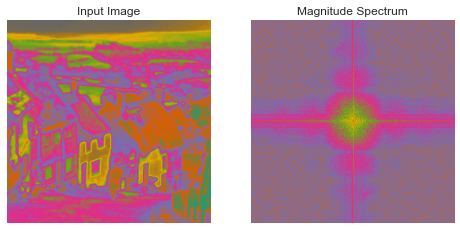

In [116]:
img = cv2.imread("/Users/alfiya/Documents/work/Image Quality/tid2013/reference_images/goldhill.png", 0)
print(img.shape)
noise = np.zeros(img.shape, np.uint8)
cv2.randn(noise, (0), (99)) 

blur = np.zeros(img.shape, np.uint8)
cv2.GaussianBlur(img, (7,7), 5, blur)
magnitude_spectrum, actual_magnitude = magnitude(img, verbose=True)
magnitude_spectrum_, actual_magnitude_ = magnitude(img + noise, verbose=True)
magnitude_spectrum__, actual_magnitude__ = magnitude(blur, verbose=True)

In [117]:
m, n = magnitude_spectrum.shape
a, b = int(m / 2), int(n / 2)
y, x = np.ogrid[-a: m - a, -b: n - b]

12142.7
40776.0
4604.22


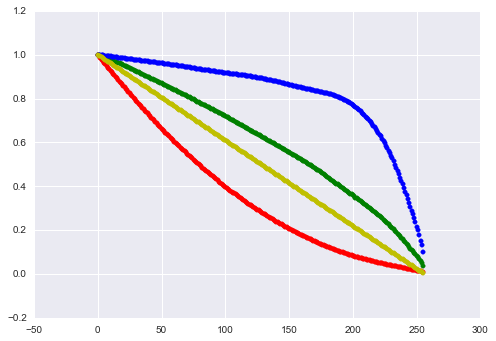

In [118]:
r = 257
mask = x * x + y * y <= r * r
s_0 = actual_magnitude[mask].sum()
print(s_0)
h = []
for r in np.arange(257, 1, -1):
    mask = x * x + y * y <= r * r
    s_1 = actual_magnitude[mask].sum()
    h.append(s_1/s_0)
#     print(s_1, s_1/s_0)
actual_magnitude.sum()

r = 257
mask = x * x + y * y <= r * r
s_0 = actual_magnitude_[mask].sum()
print(s_0)
h_ = []
for r in np.arange(257, 1, -1):
    mask = x * x + y * y <= r * r
    s_1 = actual_magnitude_[mask].sum()
    h_.append(s_1/s_0)
#     print(s_1, s_1/s_0)
actual_magnitude_.sum()

r = 257
mask = x * x + y * y <= r * r
s_0 = actual_magnitude__[mask].sum()
print(s_0)
h__ = []
for r in np.arange(257, 1, -1):
    mask = x * x + y * y <= r * r
    s_1 = actual_magnitude__[mask].sum()
    h__.append(s_1/s_0)
#     print(s_1, s_1/s_0)
actual_magnitude__.sum()

ideal_energy = 1 - np.arange(0, 257-1) / float((257-1))
plt.scatter(np.arange(0, 257-1), h, color="g")
plt.scatter(np.arange(0, 257-1), h_, color="r")
plt.scatter(np.arange(0, 257-1), h__, color="b")
plt.scatter(np.arange(0, 257-1), ideal_energy, color="y" )